# Building a transition graph between cell states from single-cell RNA velocities 
* Subset from Zebrahub
* Merge velocity counts 
* Perform analysis of cell fate probabilities for progenitor populations


<br>Nov 3rd 2022

In [197]:
import scvelo as scv
import numpy as np
import os
import scanpy as sc
import pandas as pd
import seaborn as sns

scv.settings.set_figure_params('scvelo')  # for beautified visualization
sns.set_style('white', {'legend.frameon':True})

In [198]:
import os

os.getpid()

73906

In [199]:
VELO_DIR = '/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/velocity_objects/' # velocity object with all cells 

In [200]:
## Raw velocity counts for Zebrahub 
# Load this file if you want to analyse velocity with a new UMAP 
# VELO_DIR +  "velocyto_Zebrahub_115k_cells.h5ad"

# Files 
* Early timepoint UMAP annotated by Merlin 
* Early timepoint h5ad with velocity counts 



Annotated file 

In [201]:
adata_early = sc.read_h5ad('/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/early_timepoints/danio_atlas_umapv2_annotated.h5ad')

In [202]:
VELO_DIR = '/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/velocity_objects/' 
adata_velo = sc.read_loom(VELO_DIR + "velocyto_38k_cells.loom")

In [203]:
seurat_meta = pd.read_csv("/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/early_timepoints/seurat_metadata_Nov2022.csv", index_col = 0)

In [204]:
seurat_meta.shape

(38189, 24)

In [205]:
adata_velo

AnnData object with n_obs × n_vars = 38189 × 32057
    obs: '10X_run', 'barcode', 'batch', 'cell_annotation', 'cell_id', 'cell_id2', 'global_annotation', 'timepoint'
    var: 'gene_id', 'gene_name'
    layers: 'matrix', 'spliced', 'unspliced'

In [206]:
adata_early.obs['seurat_clusters_res1.5'] = seurat_meta.loc[adata_early.obs.index.to_list()]['seurat_clusters']

In [207]:
adata_early.obs['seurat_clusters_res1.5'] = adata_early.obs['seurat_clusters_res1.5'].astype(str)

The Seurat clusters were computed directly on the integrated latent space and therefore reflect the data structure. <br>
Leiden clustering was later, it looks cleaner, but might be too high resolution.

In [208]:
# master label for velocity, etc. 
use_clusters = 'seurat_clusters_res1.5'

... storing 'seurat_clusters_res1.5' as categorical


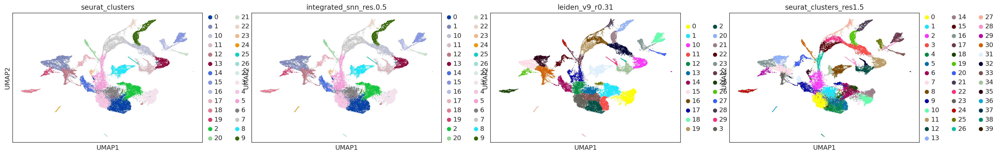

In [209]:
sc.pl.umap(adata_early, color= ['seurat_clusters','integrated_snn_res.0.5','leiden_v9_r0.31', use_clusters])

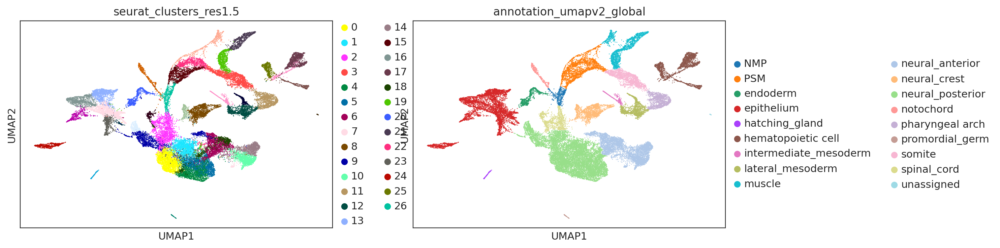

In [210]:
sc.pl.umap(adata_early, color= [use_clusters,'annotation_umapv2_global'])

In [211]:
adata_velo.obs.set_index('cell_id', inplace = True, drop = False )

adata_velo.var = adata_velo.var.astype(str)
adata_velo.var.set_index('gene_name', inplace = True, drop = False)

adata_velo.var_names_make_unique() 

In [212]:
adata_velo.obs.head() 

,10X_run,barcode,batch,cell_annotation,cell_id,cell_id2,global_annotation,timepoint
cell_id,,,,,,,,
TDR18_AAACCCAAGAGGTGCT-1,TDR18,AAACCCAAGAGGTGCT,1,Ectoderm_dlx3b,TDR18_AAACCCAAGAGGTGCT-1,TDR18_AAACCCAAGAGGTGCT-1,Epidermal,10somite
TDR18_AAACCCAAGGCGAAGG-1,TDR18,AAACCCAAGGCGAAGG,1,hindbrain_sox19a.mdkb.mex3b,TDR18_AAACCCAAGGCGAAGG-1,TDR18_AAACCCAAGGCGAAGG-1,Neural_Posterior,10somite
TDR18_AAACCCACAACCGACC-1,TDR18,AAACCCACAACCGACC,1,OpticPrimordium_rx1.rx3.six3b,TDR18_AAACCCACAACCGACC-1,TDR18_AAACCCACAACCGACC-1,Neural_Anterior,10somite
TDR18_AAACGAATCATCCCGT-1,TDR18,AAACGAATCATCCCGT,1,Epiderm_cldni,TDR18_AAACGAATCATCCCGT-1,TDR18_AAACGAATCATCCCGT-1,Epidermal,10somite
TDR18_AAACGCTCACGAGAAC-1,TDR18,AAACGCTCACGAGAAC,1,PharyngalArc_tpm4a.cxcl12b.twist1a,TDR18_AAACGCTCACGAGAAC-1,TDR18_AAACGCTCACGAGAAC-1,Lateral_Mesoderm,10somite


Both objects agree on the number of cells! This is great; no need to find overlapping cells

In [213]:
adata_velo[adata_early.obs.index.to_list()]

View of AnnData object with n_obs × n_vars = 38189 × 32057
    obs: '10X_run', 'barcode', 'batch', 'cell_annotation', 'cell_id', 'cell_id2', 'global_annotation', 'timepoint'
    var: 'gene_id', 'gene_name'
    layers: 'matrix', 'spliced', 'unspliced'

Load Zebrahub (final version of the object) and subset for the cells in there

In [214]:
zf_full = sc.read_h5ad('/mnt/ibm_lg/alejandro/danio-atlas/zebrahub/final_objects/v4/zf_atlas_full_v4_release.h5ad')


In [215]:
common_cells = intersection(zf_full.obs.index.to_list(), 
             adata_early.obs.index.to_list()) 

In [216]:
len(common_cells)

36915

In [217]:
zf_full[zf_full.obs.timepoint.isin(['10hpf','12hpf','14hpf','16hpf','19hpf','24hpf'])]

View of AnnData object with n_obs × n_vars = 36922 × 32060
    obs: 'n_genes', 'n_counts', 'fish', 'timepoint_cluster', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_nc', 'pct_counts_nc', 'developmental_stage', 'timepoint', 'zebrafish_anatomy_ontology_class', 'zebrafish_anatomy_ontology_id'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'nc', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'global_annotation_colors', 'timepoint_colors', 'zebrafish_anatomy_ontology_class_colors', 'zebrafish_anatomy_ontology_id_colors'
    obsm: 'X_umap'
    layers: 'counts'

In [218]:
adata_early = adata_early[common_cells].copy() 

In [219]:
adata_early = adata_early[adata_early.obs.annotation_umapv2_recluster != 'to_remove'].copy() 

In [220]:
adata_early[adata_early.obs.timepoint=='30somite'].obs.fish.value_counts() 

TDR44    4584
TDR46    4131
TDR43    2709
TDR45    1445
Name: fish, dtype: int64

In [226]:

def quick_sc_normalization(adata_obj): 
    sc.pp.filter_genes(adata_obj, min_cells=3)

    #adata_obj.layers['counts'] = adata_obj.X.copy() 

    sc.pp.normalize_total(adata_obj, target_sum=1e4)
    sc.pp.log1p(adata_obj)

    adata_obj.raw = adata_obj.copy() 

    sc.pp.highly_variable_genes(adata_obj, min_mean=0.0125, max_mean=3, min_disp=0.5)
    #sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
    sc.pp.scale(adata_obj, max_value=10)
    print('PCA....')
    sc.tl.pca(adata_obj, n_comps = 100, svd_solver='arpack')
    
    return adata_obj

def quick_sc_clustering(adata_obj, n_pcs= 50, k_neigh = 30 ):
    print('Neighbors....')
    sc.pp.neighbors(adata_obj, 
                   metric='cosine', 
                   n_neighbors= k_neigh  , n_pcs=n_pcs )
    print('UMAP....')
    sc.tl.umap(adata_obj, min_dist=0.3)
    #print('Leiden clusters....')
    #sc.tl.leiden(adata_obj)

    return adata_obj

# Dec 8th 2021 
# cell_id is the common column for merging 
# 



# Velocity functions 

def intersection(lst1, lst2):
    return list(set(lst1) & set(lst2))



def mergeVelocity(velo_adata, subset_adata, 
                  copy_cols = ['seurat_clusters'], 
                  use_cluster_id = 'seurat_clusters', # which obs to use as cluster ID // Required by scvelo
                  run_vanilla = False, npc = 50, k = 30  ):
    # Merge velocity counts with a reference adata object 
    # subset adata it's only used for the cell_ids and the umap, we are not using the counts at all 
        
    # 1. subset according to the reference object 
    overlap_cells = intersection(velo_adata.obs.index.tolist() , 
                            subset_adata.obs.index.tolist() )
    
    
    velo_subset  = velo_adata[overlap_cells].copy() 
    # 2. sort in the same order 
    velo_subset = velo_subset[subset_adata[overlap_cells].obs_names].copy() 
    
    # 3.optional -- if the object has not been normalized, clustered, etc we can run this step 
    velo_subset.layers['counts'] = velo_subset.X.copy() 
    
    if(run_vanilla):     
        velo_subset = quick_sc_normalization(velo_subset.copy() )
        velo_subset = quick_sc_clustering(velo_subset.copy() , npc, k )
    
    # 4. replace UMAP with reference version 
    # 
    # Save cluster ID (Required)
    velo_subset.obs['clusters']  = subset_adata[overlap_cells].obs[use_cluster_id]
    
    # keep Scanpy UMAP -- for debugging and later reference (we don't use it)
    #
    velo_subset.obsm['X_umap_sc'] = velo_subset.obsm['X_umap'].copy()
    
    # Save UMAP (required)
    velo_subset.obsm['X_umap'] =subset_adata[overlap_cells].obsm['X_umap'].toarray() # for some reason it is stored as ArrayView]
    # Save additional obs (Optional)
    for c in copy_cols:         
        velo_subset.obs[c] = subset_adata[overlap_cells].obs[c]
    
    return velo_subset 




def velo_analysis(adata_obj, clus_label = 'clusters'):
    scv.utils.show_proportions(adata_obj)

    adata_obj.X = adata_obj.layers['counts'].copy()  # sc.velo uses unnormalized counts

    scv.pp.filter_and_normalize(adata_obj, min_shared_counts=20, n_top_genes=3000)
    scv.pp.moments(adata_obj, n_pcs=50, n_neighbors=30)

    scv.tl.velocity(adata_obj, mode='stochastic')


    scv.tl.velocity_graph(adata_obj)
    # Add cluster label 
    if(clus_label != 'clusters'):
        adata_obj.obs['clusters'] = adata_obj.obs[clus_label]
        
    return adata_obj




In [227]:
adata_velo.obs.head()

,10X_run,barcode,batch,cell_annotation,cell_id,cell_id2,global_annotation,timepoint
cell_id,,,,,,,,
TDR18_AAACCCAAGAGGTGCT-1,TDR18,AAACCCAAGAGGTGCT,1,Ectoderm_dlx3b,TDR18_AAACCCAAGAGGTGCT-1,TDR18_AAACCCAAGAGGTGCT-1,Epidermal,10somite
TDR18_AAACCCAAGGCGAAGG-1,TDR18,AAACCCAAGGCGAAGG,1,hindbrain_sox19a.mdkb.mex3b,TDR18_AAACCCAAGGCGAAGG-1,TDR18_AAACCCAAGGCGAAGG-1,Neural_Posterior,10somite
TDR18_AAACCCACAACCGACC-1,TDR18,AAACCCACAACCGACC,1,OpticPrimordium_rx1.rx3.six3b,TDR18_AAACCCACAACCGACC-1,TDR18_AAACCCACAACCGACC-1,Neural_Anterior,10somite
TDR18_AAACGAATCATCCCGT-1,TDR18,AAACGAATCATCCCGT,1,Epiderm_cldni,TDR18_AAACGAATCATCCCGT-1,TDR18_AAACGAATCATCCCGT-1,Epidermal,10somite
TDR18_AAACGCTCACGAGAAC-1,TDR18,AAACGCTCACGAGAAC,1,PharyngalArc_tpm4a.cxcl12b.twist1a,TDR18_AAACGCTCACGAGAAC-1,TDR18_AAACGCTCACGAGAAC-1,Lateral_Mesoderm,10somite


In [228]:
adata_early.obs.head()

,orig.ident,X10X_run,fish,fish_n,timepoint,seqrun,cell_annotation,global_annotation,integrated_snn_res.0.5,seurat_clusters,...,leiden_v5_r0.35,leiden_v6_r0.32,leiden_v7_r0.3,leiden_v8_r0.31,leiden_v9_r0.31,leiden_v10_r0.25,leiden_v11_r0.22,leiden_v12_r0.23,annotation_umapv2_global,seurat_clusters_res1.5
TDR38_TAGAGTCCAGACCAAG-1,TDR38,TDR38,TDR38,38,05somite,1,Telencaphalon_Emx3,Neural_Anterior,2,2,...,11,12,12,11,11,12,14,14,neural_posterior,4
TDR44_ATAGACCTCGCACTCT-1,TDR44,TDR44,TDR44,44,30somite,1,Midbrain_en2b_pax5_en2a,Neural_Posterior,0,0,...,11,12,12,11,11,12,14,14,neural_posterior,4
TDR43_TCAGGGCTCTTGCGCT-1,TDR43,TDR43,TDR43,43,30somite,1,EndothelialCells_kdrl,Epidermal,16,16,...,24,24,23,23,23,20,20,20,hematopoietic cell,25
TDR18_CCTCACAGTAGATTAG-1,TDR18,TDR18,TDR18,18,10somite,1,PSM_msgn1,PSM,7,7,...,18,19,9,19,19,3,5,3,PSM,15
TDR39_CCCATTGCAGACACAG-1,TDR39,TDR39,TDR39,39,15somite,1,OpticCup_rx1,Neural_Anterior,3,3,...,6,6,1,0,0,1,2,1,neural_anterior,37


## Velocity pipeline
Nov 3rd 2022 <br>
* Merge annotations with velocyto counts 
* Normalize using scVelo functions 
* Compute moments
* Compute velocities 
* Compute velocity graph
* Visualization

In [229]:
use_clusters

'seurat_clusters_res1.5'

Check that we have log-norm counts on adata.X

In [230]:
np.sum(np.expm1(adata_early.X), axis = 1)

matrix([[ 9999.79 ],
        [10000.   ],
        [10000.   ],
        ...,
        [10000.   ],
        [ 9999.999],
        [10000.   ]], dtype=float32)

In [420]:

# Use the leiden clustering from Merlin as a reference for velocity 
# adata_velo_early = mergeVelocity(adata_velo , adata_early,
#                            run_vanilla = False, 
#                            copy_cols = ['annotation_umapv2_recluster'], 
#                            use_cluster_id = 'leiden_v10_r0.25', 
#                           )


# Use the original seurat clusters as reference for the velocity (probably more accurate)
# Note Nov 10th 2022 -- works 
# Option1: No normalization --- we can do with scVelo
# adata_velo_early = mergeVelocity(adata_velo , adata_early,
#                            run_vanilla = False, 
#                            copy_cols = ['annotation_umapv2_recluster','annotation_umapv2_global'], 
#                            use_cluster_id = use_clusters, 
#                           )


# Option2: Run PCA and neighbors with scanpy -- scVelo will take those later (Nov 10th 2022)
adata_velo_early = mergeVelocity(adata_velo , adata_early,
                           run_vanilla = True, 
                           copy_cols = ['annotation_umapv2_recluster','annotation_umapv2_global'], 
                           use_cluster_id = use_clusters, 
                           k = 20, npc = 50
                          )


PCA....
Neighbors....
UMAP....


In [421]:
adata_velo_early.obs.head() 

,10X_run,barcode,batch,cell_annotation,cell_id,cell_id2,global_annotation,timepoint,clusters,annotation_umapv2_recluster,annotation_umapv2_global
cell_id,,,,,,,,,,,
TDR38_TAGAGTCCAGACCAAG-1,TDR38,TAGAGTCCAGACCAAG,0,Telencaphalon_Emx3,TDR38_TAGAGTCCAGACCAAG-1,TDR38_TAGAGTCCAGACCAAG-1,Neural_Anterior,05somite,4,midbrain_en2a_pax5,neural_posterior
TDR44_ATAGACCTCGCACTCT-1,TDR44,ATAGACCTCGCACTCT,0,Midbrain_en2b.pax5.en2a,TDR44_ATAGACCTCGCACTCT-1,TDR44_ATAGACCTCGCACTCT-1,Neural_Posterior,30somite,4,midbrain_en2a_pax5,neural_posterior
TDR43_TCAGGGCTCTTGCGCT-1,TDR43,TCAGGGCTCTTGCGCT,0,EndothelialCells_kdrl,TDR43_TCAGGGCTCTTGCGCT-1,TDR43_TCAGGGCTCTTGCGCT-1,Epidermal,30somite,25,endothelia_cells_sox7_kdrl_yvk,hematopoietic cell
TDR18_CCTCACAGTAGATTAG-1,TDR18,CCTCACAGTAGATTAG,1,PSM_msgn1,TDR18_CCTCACAGTAGATTAG-1,TDR18_CCTCACAGTAGATTAG-1,PSM,10somite,15,psm_msgn1_hes6,PSM
TDR39_CCCATTGCAGACACAG-1,TDR39,CCCATTGCAGACACAG,0,OpticCup_rx1,TDR39_CCCATTGCAGACACAG-1,TDR39_CCCATTGCAGACACAG-1,Neural_Anterior,15somite,37,optic_cuprx1_rx2_vsx2,neural_anterior


... storing '10X_run' as categorical
... storing 'barcode' as categorical
... storing 'batch' as categorical
... storing 'cell_annotation' as categorical
... storing 'global_annotation' as categorical
... storing 'timepoint' as categorical
... storing 'gene_name' as categorical


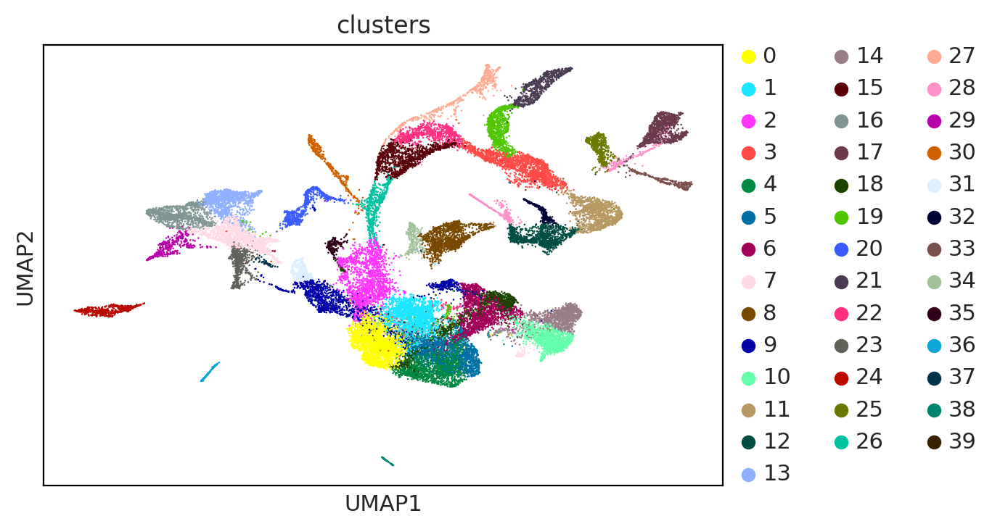

In [422]:
sc.pl.umap(adata_velo_early, color = 'clusters')

UMAP withoout batch correction 

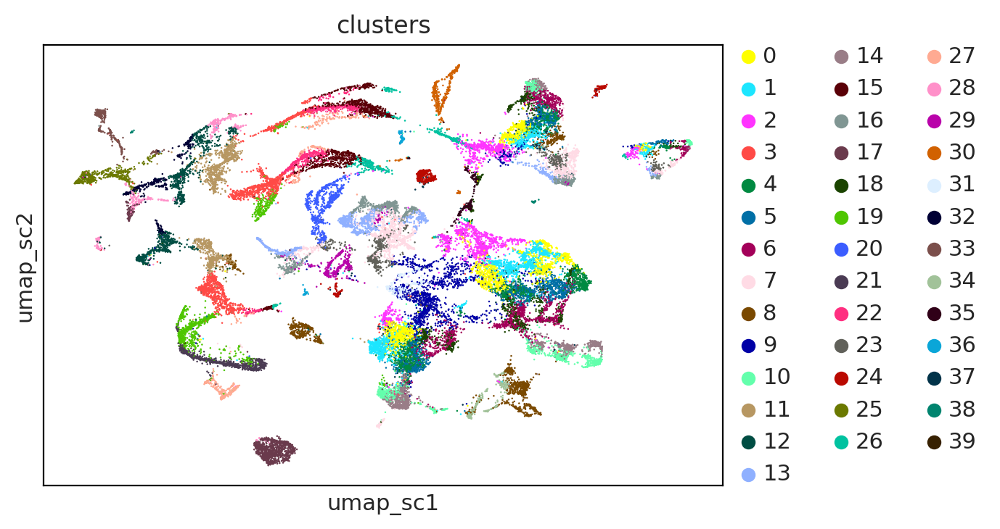

In [423]:
sc.pl.embedding(adata_velo_early, basis = 'umap_sc', color  ='clusters')

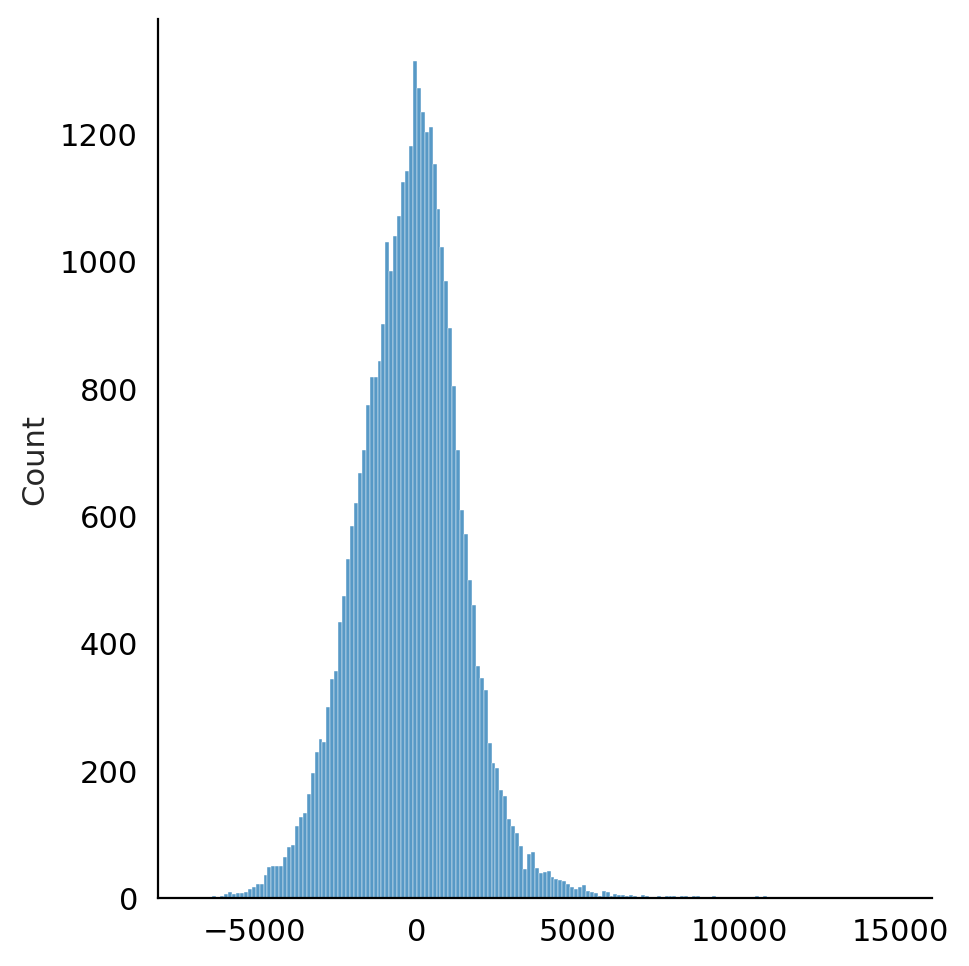

In [424]:
sns.displot(np.sum(adata_velo_early.X, axis =1 ) ) 

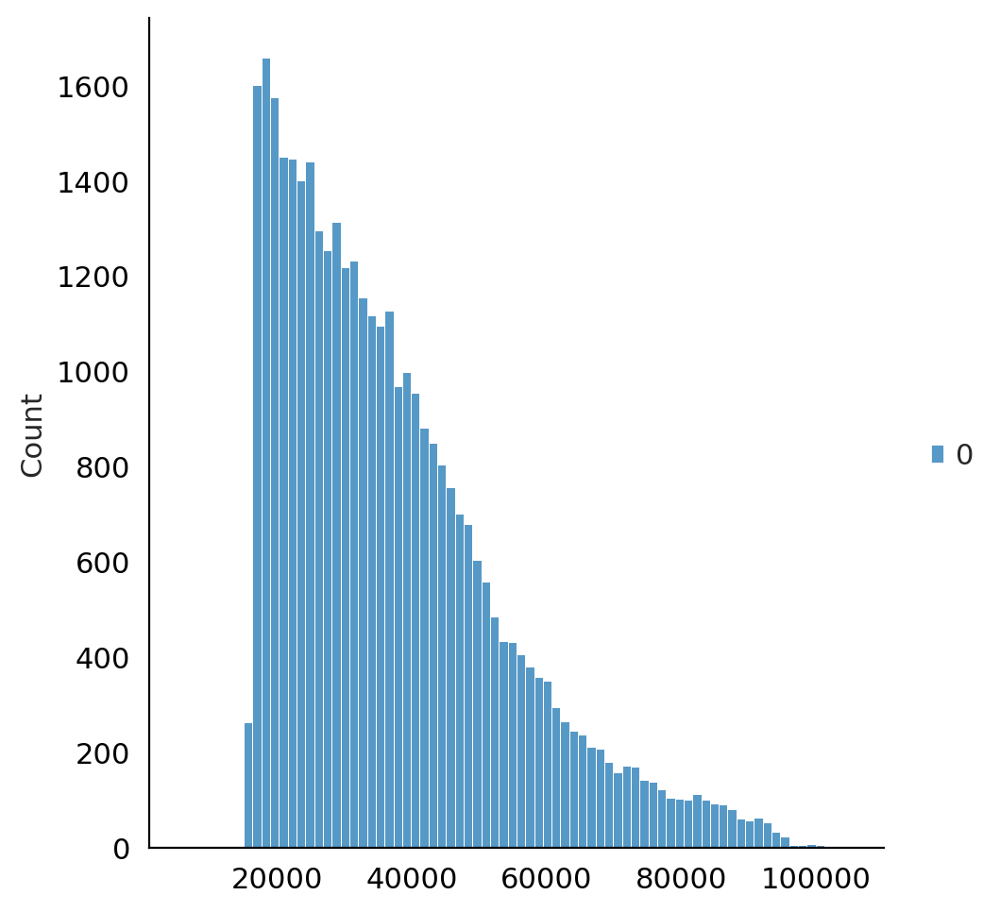

In [425]:
sns.displot(np.sum(adata_velo_early.layers['counts'], axis =1 ) ) 

Let's compute the velocity using scvelo's dynamic mode. Takes about 15-20 minutes.

In [426]:
%%time
import scvelo as scv

# v1: using scanpy counts directly!
# scv.pp.filter_and_normalize(adata_velo_early, min_shared_counts=20, n_top_genes=3000)
# scv.pp.moments(adata_velo_early, n_pcs=50, n_neighbors=50)


# v2: use scanpy's PCA and neighbors 
adata_velo_early.X = adata_velo_early.layers['counts'].copy() # reset to raw counts
scv.pp.filter_and_normalize(adata_velo_early, min_shared_counts=20, n_top_genes=3000)
scv.pp.moments(adata_velo_early, n_pcs=50, n_neighbors=50)

Filtered out 7256 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 3000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:24) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:13) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
CPU times: user 4min 7s, sys: 33.5 s, total: 4min 40s
Wall time: 1min 41s


In [427]:
adata_velo_early

AnnData object with n_obs × n_vars = 36870 × 3000
    obs: '10X_run', 'barcode', 'batch', 'cell_annotation', 'cell_id', 'cell_id2', 'global_annotation', 'timepoint', 'clusters', 'annotation_umapv2_recluster', 'annotation_umapv2_global', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    var: 'gene_id', 'gene_name', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'gene_count_corr'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters_colors'
    obsm: 'X_pca', 'X_umap', 'X_umap_sc'
    varm: 'PCs'
    layers: 'matrix', 'spliced', 'unspliced', 'counts', 'Ms', 'Mu'
    obsp: 'distances', 'connectivities'

In [428]:
scv.tl.recover_dynamics(adata_velo_early, n_jobs=20)

recovering dynamics (using 20/112 cores)


  0%|          | 0/2334 [00:00<?, ?gene/s]

    finished (0:18:15) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [429]:
%%time
#scv.tl.recover_dynamics(adata_velo_early, n_jobs=20)
scv.tl.velocity(adata_velo_early, mode="dynamical")


computing velocities
    finished (0:01:53) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
CPU times: user 1min 30s, sys: 23 s, total: 1min 53s
Wall time: 1min 53s


In [430]:
scv.tl.velocity_graph(adata_velo_early,n_neighbors=10)

computing velocity graph (using 1/112 cores)


  0%|          | 0/36870 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


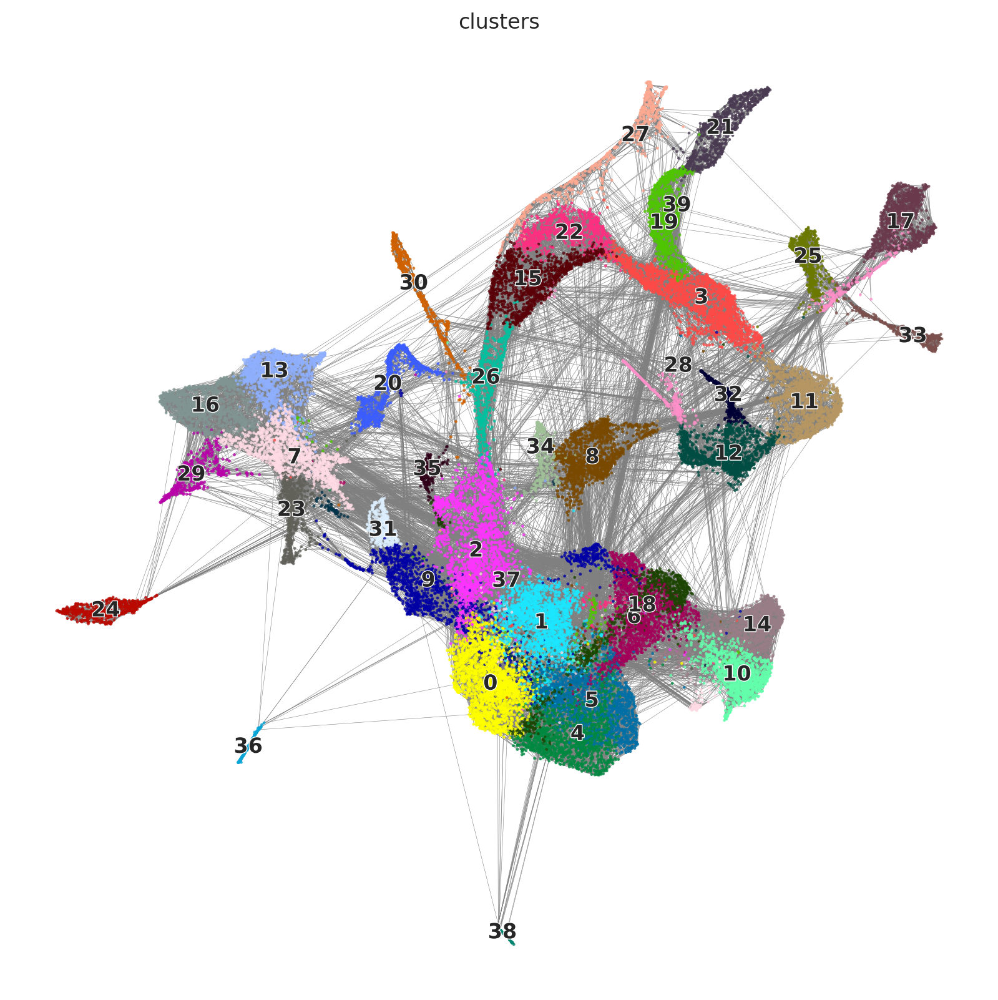

In [433]:
scv.pl.velocity_graph(adata_velo_early,
                     figsize = (10,10))

computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


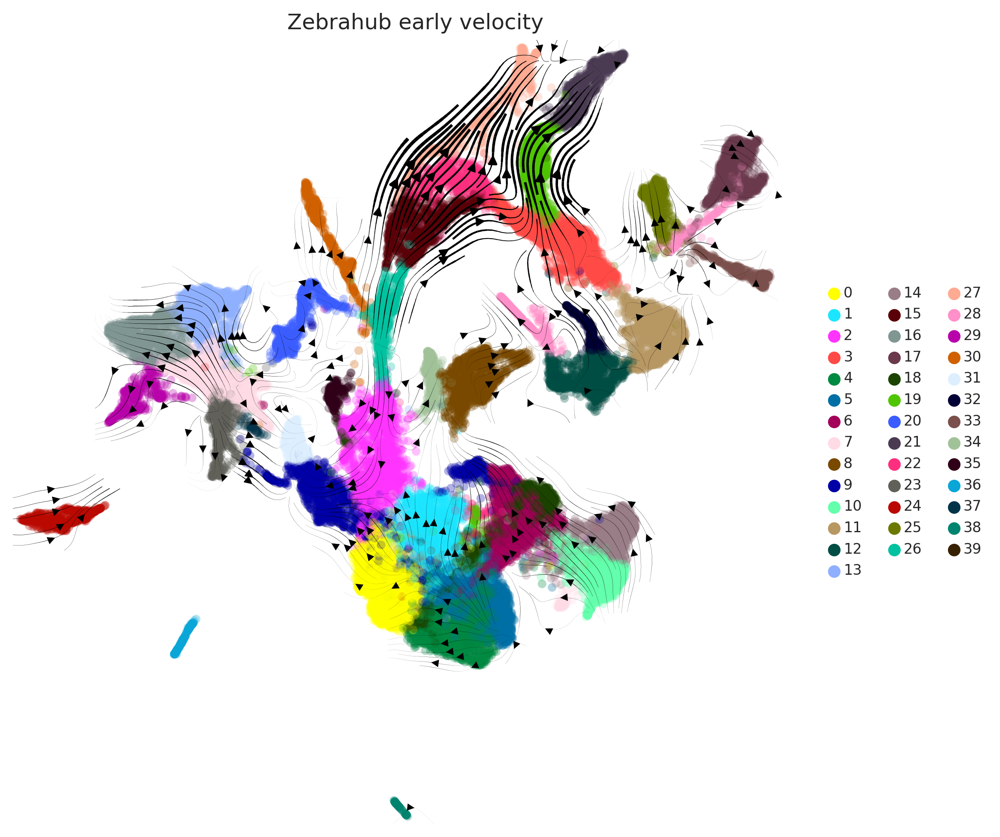

In [432]:
scv.pl.velocity_embedding_stream(adata_velo_early, basis='umap', dpi =150,
                                 legend_loc ='right margin',legend_fontsize =8,
                                 density= 5,
                                 color = 'clusters',
                                 #size = 5,
                                figsize = (8,8), title = 'Zebrahub early velocity')# , 
                                    #save = adata_list[idx].obs.timepoint[0] + '_UMAP_velocity_NOLABEL.png')


computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


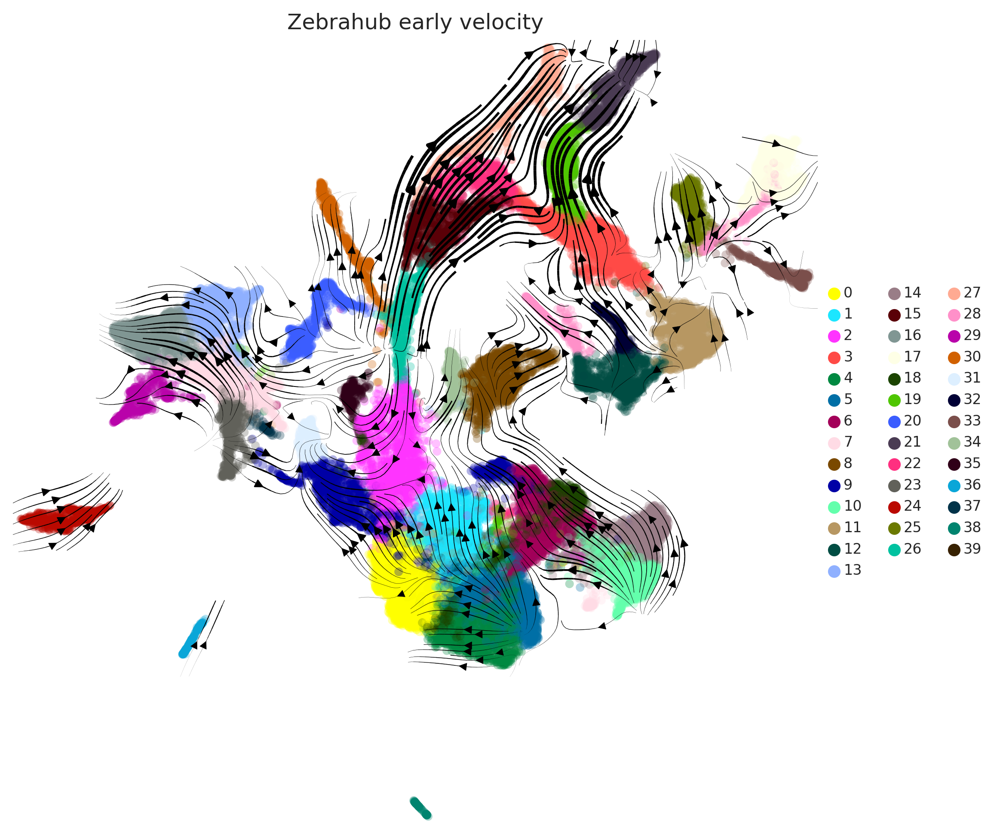

In [64]:
scv.pl.velocity_embedding_stream(adata_velo_early, basis='umap', dpi =150,
                                 legend_loc ='right margin',legend_fontsize =8,
                                 density= 5,
                                 color = 'clusters',
                                 #size = 5,
                                figsize = (8,8), title = 'Zebrahub early velocity')# , 
                                    #save = adata_list[idx].obs.timepoint[0] + '_UMAP_velocity_NOLABEL.png')


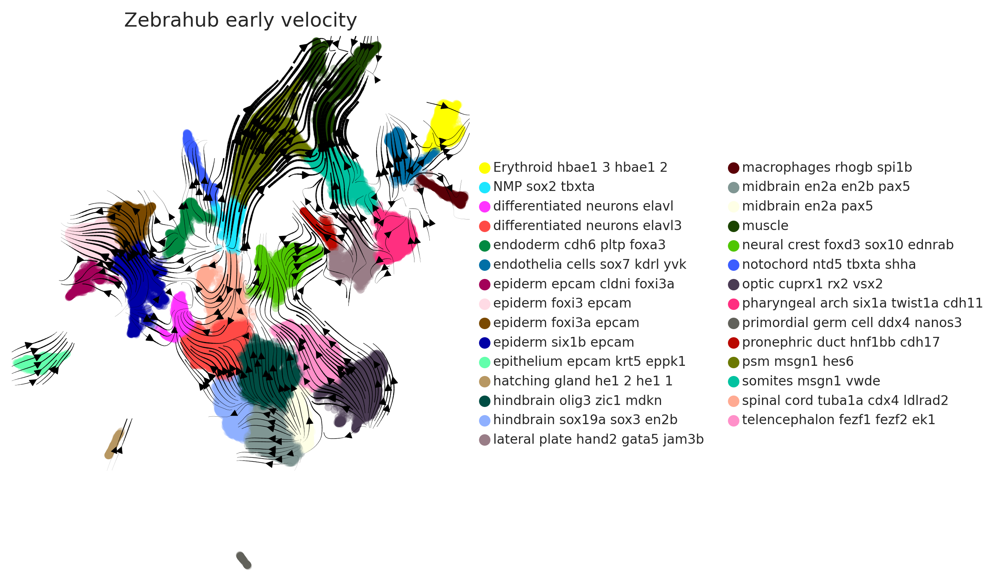

In [65]:
scv.pl.velocity_embedding_stream(adata_velo_early, basis='umap', dpi =150,
                                 legend_loc ='right margin',legend_fontsize =8,
                                 density= 5,
                                 color = 'annotation_umapv2_recluster',
                                 #size = 5,
                                figsize = (5,6), title = 'Zebrahub early velocity')# , 
                                    #save = adata_list[idx].obs.timepoint[0] + '_UMAP_velocity_NOLABEL.png')


Higher number of neighbors in Scanpy pre-processing:

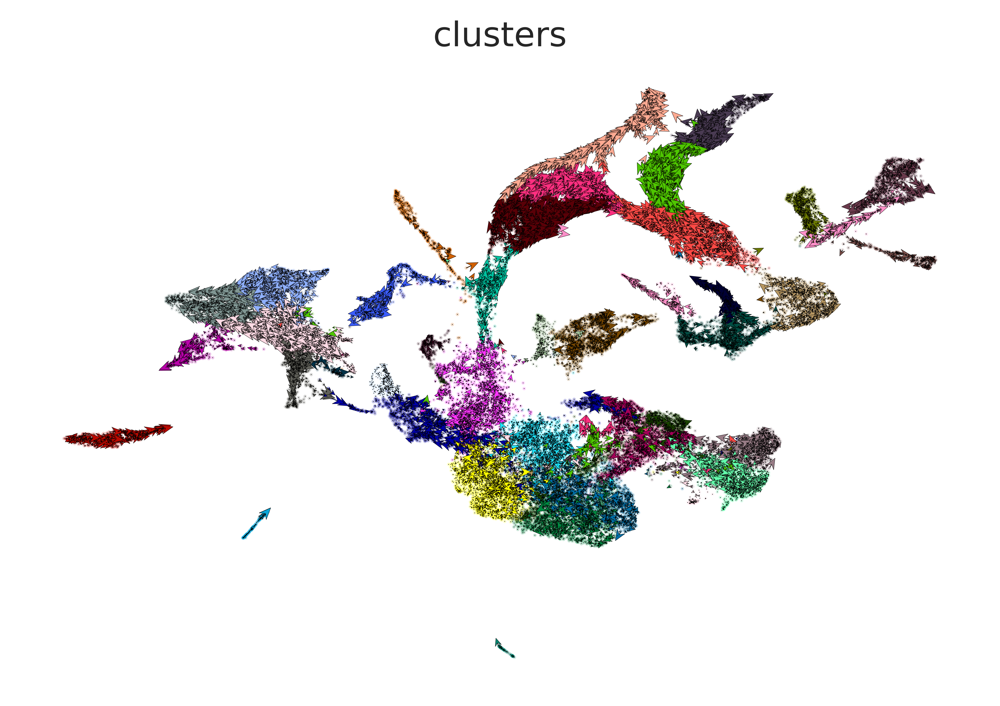

In [434]:
scv.pl.velocity_embedding(adata_velo_early, arrow_length=3, arrow_size=2, dpi=500)


Original: lower (defaul = 50) number of neighbors in Scanpy pre-processing

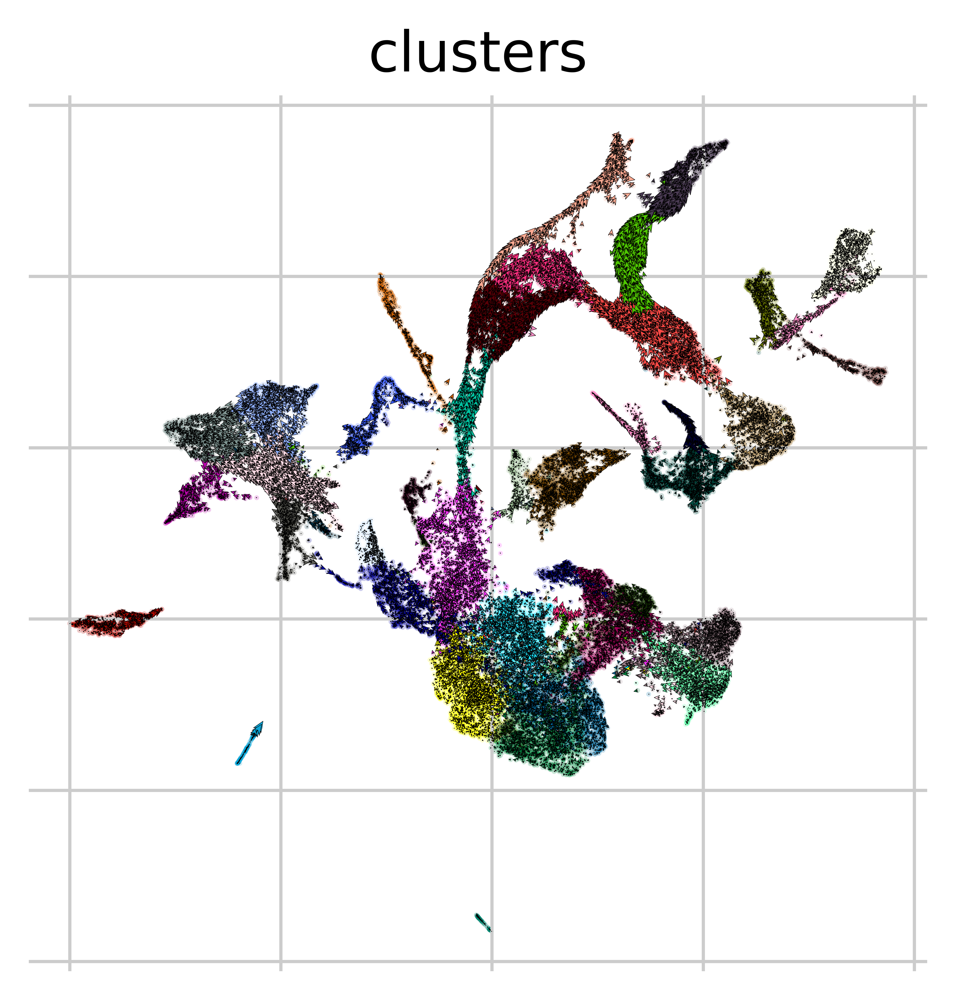

In [195]:
scv.pl.velocity_embedding(adata_velo_early, arrow_length=3, arrow_size=2, dpi=500)


There are some differences: <br>
Nov 30th 2022
* Single-cell velocities looked more aligned 
* PSM trajectory looks stronger 

In [435]:
scv.tl.velocity_confidence(adata_velo_early)


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


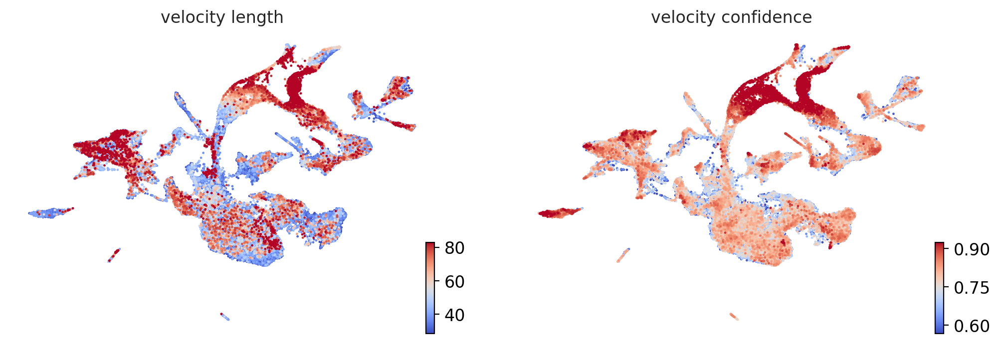

In [436]:
keys = 'velocity_length', 'velocity_confidence'

scv.pl.scatter(adata_velo_early, c=keys, cmap='coolwarm', perc=[5, 95])


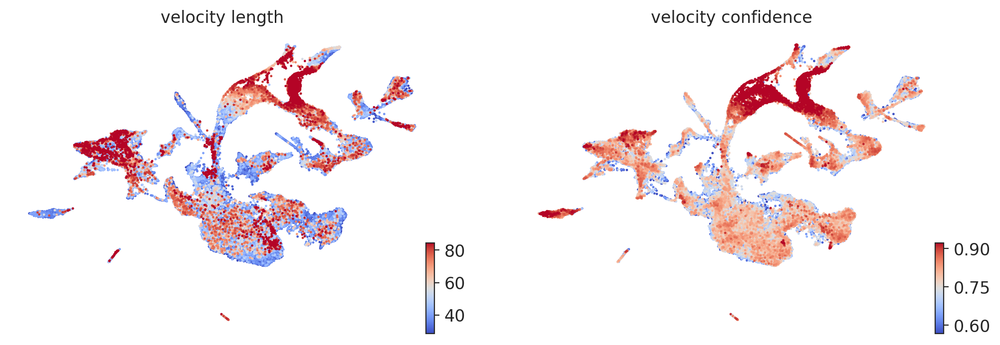

In [68]:
keys = 'velocity_length', 'velocity_confidence'

scv.pl.scatter(adata_velo_early, c=keys, cmap='coolwarm', perc=[5, 95])


**Note:** Since the velocity graph **does not** depend on the UMAP or clustering -- only on the PCA -- we don't need to re-compute the velocity. We only need to re-compute the projection to the embedding 

Ridge plot of velocity lengths 

In [437]:
sorted_tissues = ['0 budstage','05somite','10somite','15somite',
                  '20somite','30somite']

sorted_tissues_ = ['10hpf','12hpf',
'14hpf', '16hpf','19hpf','24hpf','2dpf','3dpf','5dpf','10dpf']

In [438]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_ridges_timepoint(adata  =[], #adata object 
                          var1 = 'velocity_length', 
                          axis_var = 'timepoint',
                          sorted_tissues = [], 
                          x_label = 'velocity', 
                          use_log = True):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
    
    adata_df = adata.obs[[var1,axis_var]]
    
    palette = sns.color_palette("viridis", len(set(adata_df[axis_var])))


    g = sns.FacetGrid(adata_df, palette=palette, 
                      row=axis_var, hue=axis_var, 
                      row_order =sorted_tissues, hue_order = sorted_tissues,
                     # aspect=5, height=1.2,
                     aspect=15, height=.5)
    g.map_dataframe(sns.kdeplot, x=var1, fill=True, alpha=1, log_scale = use_log)
    g.map_dataframe(sns.kdeplot, x=var1, color='black', log_scale = use_log)
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, color='black', fontsize=13,
                ha="left", va="center", transform=ax.transAxes)

    # Add vertical lines for mean age on each plot
    def vertical_threshold(x, **kwargs):
        plt.axvline(np.log10(2500), linestyle = '--', color = 'gray')

    #g.map(vertical_threshold,axis_var) 


    g.map(label,axis_var)
    g.fig.subplots_adjust(hspace=-.5)

    g.set_titles("")
    g.set(yticks=[], xlabel=x_label)
    g.despine( left=True)

    plt.suptitle('Zebrafish development velocity distribution', y=0.98)

Object 2

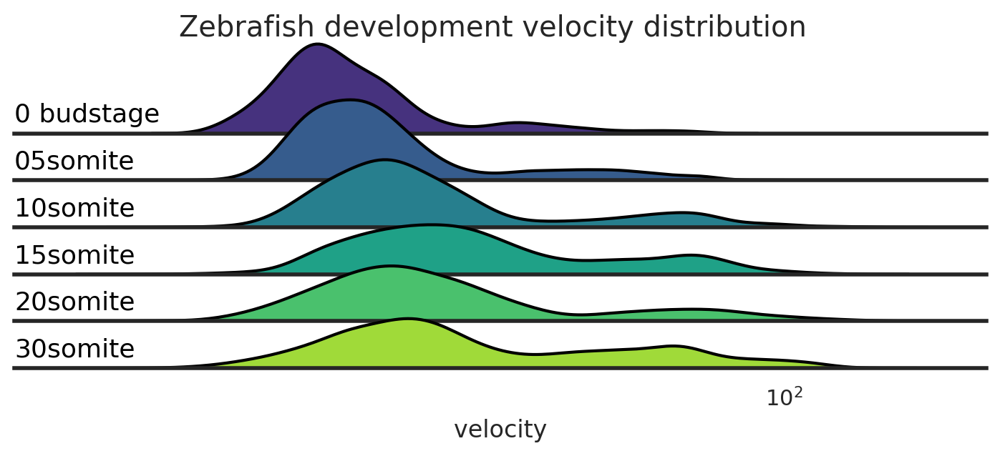

In [439]:
plot_ridges_timepoint(adata  =adata_velo_early, #adata object 
                          var1 = 'velocity_length', 
                          axis_var = 'timepoint',
                          sorted_tissues = sorted_tissues, 
                          x_label = 'velocity' , use_log = True)

We can see which cell types are changing their cell state faster according to their velocity

In [72]:
df_vel = pd.DataFrame(adata_velo_early[adata_velo_early.obs['velocity_length']>50].obs.groupby(['annotation_umapv2_global','timepoint']).size()) 
df_vel.rename(columns={0:'n_cells'},inplace = True)
df_vel.reset_index(inplace = True)
df_vel = df_vel[df_vel['n_cells']>100]
df_vel.sort_values('n_cells',ascending = False).head()

,annotation_umapv2_global,timepoint,n_cells
71,neural_posterior,30somite,1273
53,muscle,30somite,970
7,PSM,05somite,660
21,epithelium,15somite,643
22,epithelium,20somite,481


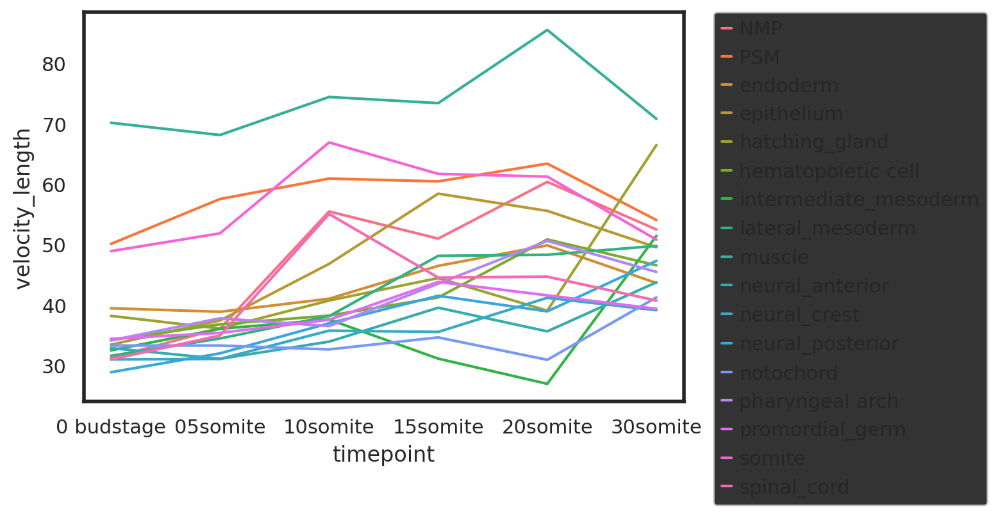

In [440]:
cell_type_label = 'annotation_umapv2_global'
velo_stats = pd.DataFrame(adata_velo_early.obs[['velocity_length','timepoint',cell_type_label]].groupby(['timepoint',cell_type_label]).mean())
velo_stats.reset_index(inplace = True)


sns.lineplot(data = velo_stats, x = 'timepoint', y ='velocity_length', hue = cell_type_label)

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

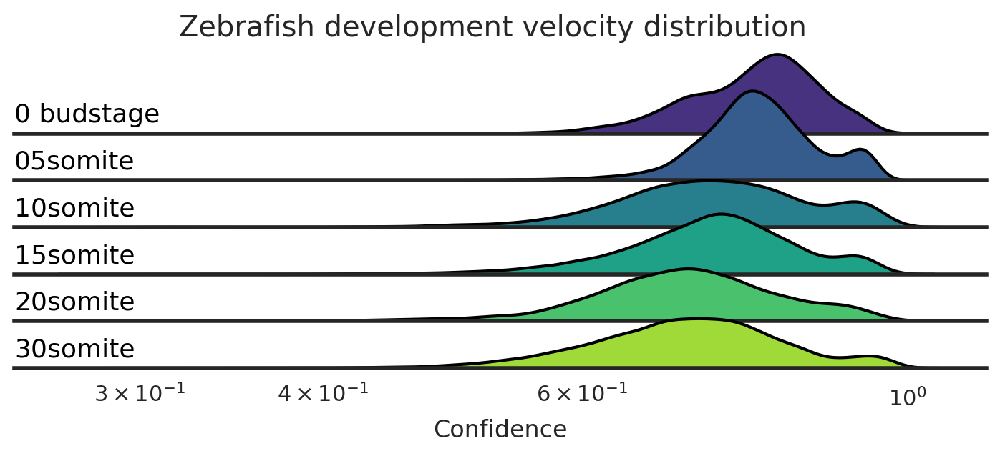

In [441]:
plot_ridges_timepoint(adata  =adata_velo_early, #adata object 
                          var1 = 'velocity_confidence', 
                          axis_var = 'timepoint',
                          sorted_tissues = sorted_tissues, 
                          x_label = 'Confidence' , use_log = True)

In [442]:
adata_velo_early[adata_velo_early.obs.timepoint=='30somite'].obs['10X_run'].unique() 

['TDR44', 'TDR43', 'TDR46', 'TDR45']
Categories (4, object): ['TDR43', 'TDR44', 'TDR45', 'TDR46']

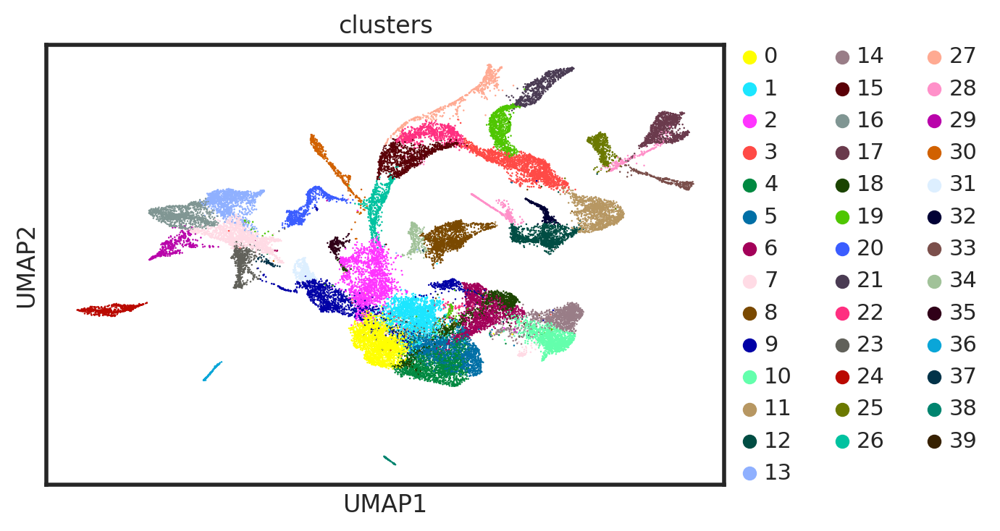

In [443]:
sc.pl.umap(adata_velo_early, color = 'clusters') 

* The velocity lengths look fine when using the 3D umap
* We see an interesting trend in velocity length and confidence (alignment of arrows within a cluster) 

# CellRank

In [444]:
# Run this if the velocity is not from a dynamical modeling 

# scv.tl.recover_dynamics(adata_velo_proc, n_jobs=20)

# scv.tl.velocity(adata_velo_proc, mode="dynamical")
# scv.tl.velocity_graph(adata_velo_proc)

In [445]:
adata_velo_early

AnnData object with n_obs × n_vars = 36870 × 3000
    obs: '10X_run', 'barcode', 'batch', 'cell_annotation', 'cell_id', 'cell_id2', 'global_annotation', 'timepoint', 'clusters', 'annotation_umapv2_recluster', 'annotation_umapv2_global', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition'
    var: 'gene_id', 'gene_name', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'gene_count_corr', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters_colors', 'recover_dynamics', 'velocity_params', 'velocity_graph', 'velocity_graph_neg'
    obsm: 'X_pca', 'X_umap', 'X_umap_sc', 've

In [446]:
cell_type_label

'annotation_umapv2_global'

figure cannot be saved as pdf, using png instead.
saving figure to file figures/early_UMAP_velocity_.png


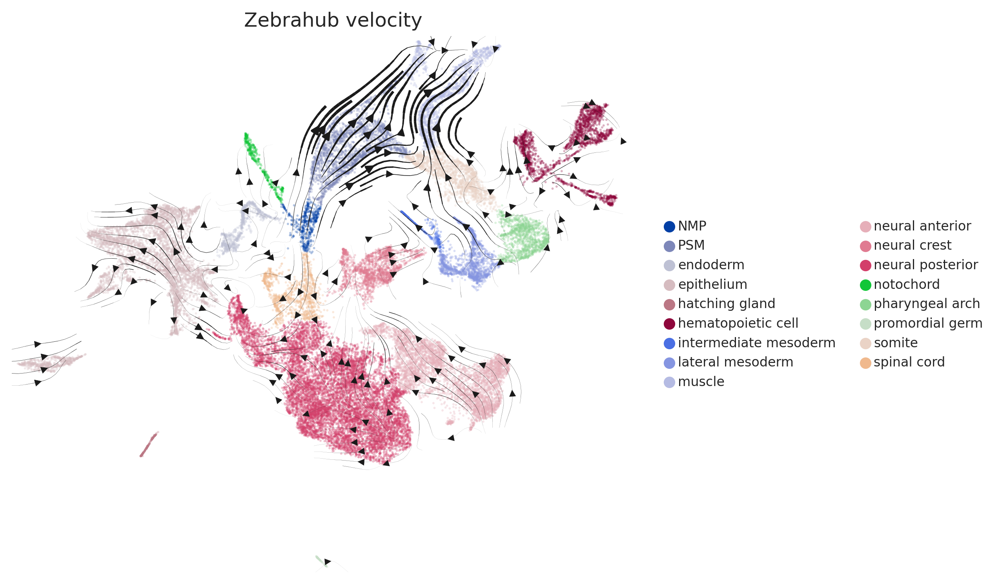

In [447]:
scv.settings.set_figure_params('scvelo')  # for beautified visualization


scv.pl.velocity_embedding_stream(adata_velo_early, basis='umap', dpi =150,
                                 legend_loc ='right margin',legend_fontsize =8,
                                 density= 3,
                                 color = cell_type_label,
                                 size = 8,
                                figsize = (7,6), title = 'Zebrahub velocity',# , 
                                save =  'figures/early_UMAP_velocity_.pdf')


saving figure to file figures/early_UMAP_velocity_.pdf


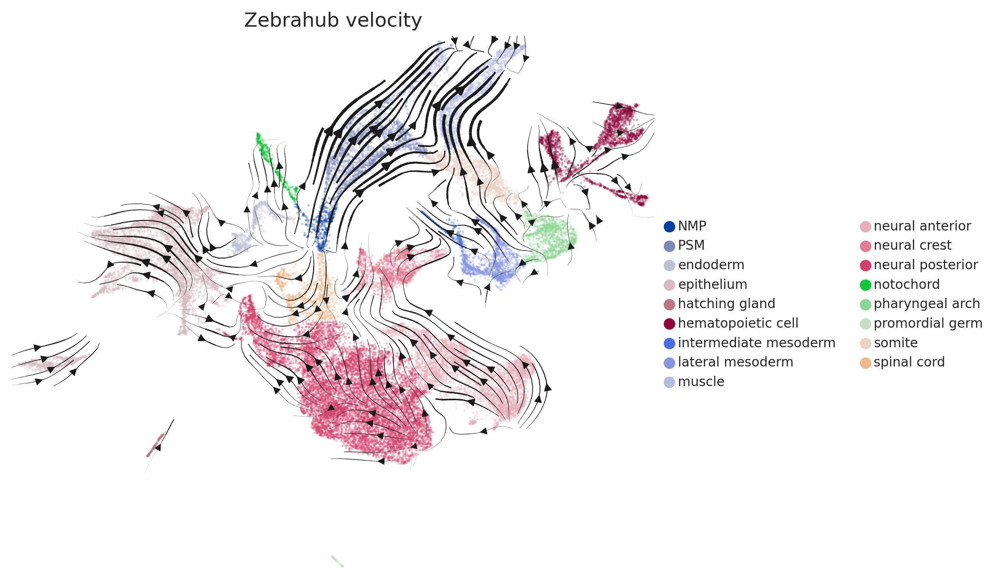

In [87]:
scv.settings.set_figure_params('scvelo')  # for beautified visualization


scv.pl.velocity_embedding_stream(adata_velo_early, basis='umap', dpi =150,
                                 legend_loc ='right margin',legend_fontsize =8,
                                 density= 3,
                                 color = cell_type_label,
                                 size = 8,
                                figsize = (7,6), title = 'Zebrahub velocity',# , 
                                save =  'figures/early_UMAP_velocity_.pdf')


In [448]:
del adata_velo_early.obs['cell_id']

In [449]:
del adata_velo_early.var['gene_name']

In [450]:
del adata_velo_early.raw

In [261]:
#adata_velo_early.write(VELO_DIR  + 'velocyto_Zebrahub_Early_38k_cells_v2UMAP_processedDynamic.h5ad')
adata_velo_early.write(VELO_DIR  + 'velocyto_Zebrahub_Early_38k_cells_v2UMAP_processedDynamic_scanpyPre_v3.h5ad') # pre-processed with Scanpy (Normalization, filtering, PCA, neighbors)-- Nov 10th 2022

In [130]:
VELO_DIR  + 'velocyto_Zebrahub_Early_38k_cells_v2UMAP_processedDynamic_scanpyPre.h5ad'

'/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/velocity_objects/velocyto_Zebrahub_Early_38k_cells_v2UMAP_processedDynamic_scanpyPre.h5ad'

In [213]:
VELO_DIR

'/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/velocity_objects/'

# Analysis: in depth 
Velocity model: scvelo dynamical <br>
Data: Full Zebrahub 1.0 <br>
We start by running the basic cell rank functions to get: 
* A transition probability matrix 
* A clustering of the velocity graph (macro states) 

In [3]:
VELO_DIR = '/mnt/ibm_lg/alejandro/danio-atlas/atlas_objects/velocity_objects/'

#adata_velo_early = sc.read_h5ad(VELO_DIR  + 'velocyto_Zebrahub_Early_38k_cells_v2UMAP_processedDynamic_scanpyPre_v2.h5ad')

# higher k during scanpy pre-processing (might improve the velocity flow)
adata_velo_early = sc.read_h5ad(VELO_DIR  + 'velocyto_Zebrahub_Early_38k_cells_v2UMAP_processedDynamic_scanpyPre_v3.h5ad')

In [451]:
import scvelo as scv
import numpy as np
import os
import scanpy as sc
import pandas as pd
import seaborn as sns 

scv.settings.set_figure_params('scvelo')  # for beautified visualization

In [452]:
adata_velo_early

AnnData object with n_obs × n_vars = 36870 × 3000
    obs: '10X_run', 'barcode', 'batch', 'cell_annotation', 'cell_id2', 'global_annotation', 'timepoint', 'clusters', 'annotation_umapv2_recluster', 'annotation_umapv2_global', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition'
    var: 'gene_id', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'gene_count_corr', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters_colors', 'recover_dynamics', 'velocity_params', 'velocity_graph', 'velocity_graph_neg', 'annotation_umapv2_global_colors'
    obsm: 'X_pca', 'X_umap', 'X_um

Transition Matrix from RNA velocity 


### Integrate the velocity kernel with a connectivity kernel (see the CellRank tutorial for more details) 

In [453]:
%%time 

import cellrank as cr
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.kernels import VelocityKernel

vk = VelocityKernel(adata_velo_early)


# By default, it is deterministic but a Monte Carlo option and stochastic option that propagates uncertainty are also available
# https://cellrank.readthedocs.io/en/stable/api/cellrank.tl.kernels.VelocityKernel.compute_transition_matrix.html#cellrank.tl.kernels.VelocityKernel.compute_transition_matrix

# For v2: 
# vk.compute_transition_matrix(scheme= 'cosine',  # default = correlation 
#                              mode = 'stochastic', # default = deterministic 
#                              )

# For v3, Nov 2022: 
vk.compute_transition_matrix(scheme= 'cosine',  # default = correlation 
                              mode = 'deterministic', # default = deterministic 
                            )

# include cell similarity into a single kernel
# Uses symmetric, weighted KNN graph to compute symmetric transition matrix. 
#The connectivities are computed using scanpy.pp.neighbors(). 
#Depending on the parameters used there, they can be UMAP connectivities or gaussian-kernel-based connectivities with adaptive kernel width.
ck = ConnectivityKernel(adata_velo_early).compute_transition_matrix()



  0%|          | 0/36870 [00:00<?, ?cell/s]

  0%|          | 0/36870 [00:00<?, ?cell/s]

CPU times: user 12min 19s, sys: 46min 9s, total: 58min 28s
Wall time: 2min 6s


In [454]:
combined_kernel = 0.8 * vk + 0.2 * ck

combined_kernel.transition_matrix

<36870x36870 sparse matrix of type '<class 'numpy.float64'>'
	with 2511124 stored elements in Compressed Sparse Row format>

In [359]:
combined_kernel = vk

In [360]:
import scipy.sparse
# v2
#scipy.sparse.save_npz('results/tran_matrix_stochastic.npz', combined_kernel.transition_matrix, compressed=True)

# v3 deterministic 
#scipy.sparse.save_npz('results/tran_matrix_deterministic_k300.npz', combined_kernel.transition_matrix, compressed=True)

In [455]:
combined_kernel.transition_matrix[1:10,1:10].toarray() 

array([[0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.]])

It seems that the transition matrix is well behaved ...

In [456]:
np.sum(combined_kernel.transition_matrix, axis = 1)

matrix([[1.],
        [1.],
        [1.],
        ...,
        [1.],
        [1.],
        [1.]])

In [457]:
np.sum(combined_kernel.transition_matrix[1,:]),np.sum(combined_kernel.transition_matrix[:,1])

(0.9999999999999998, 0.7823022456732164)

In [458]:
np.sum(combined_kernel.transition_matrix[1,:]>0), np.sum(combined_kernel.transition_matrix[:,1]>0)

(64, 64)

The rows add to 1, not the columns, which means that it is a **right** stochastic matrix. And should multiply from the right side ??

Let's plot the degree distribution

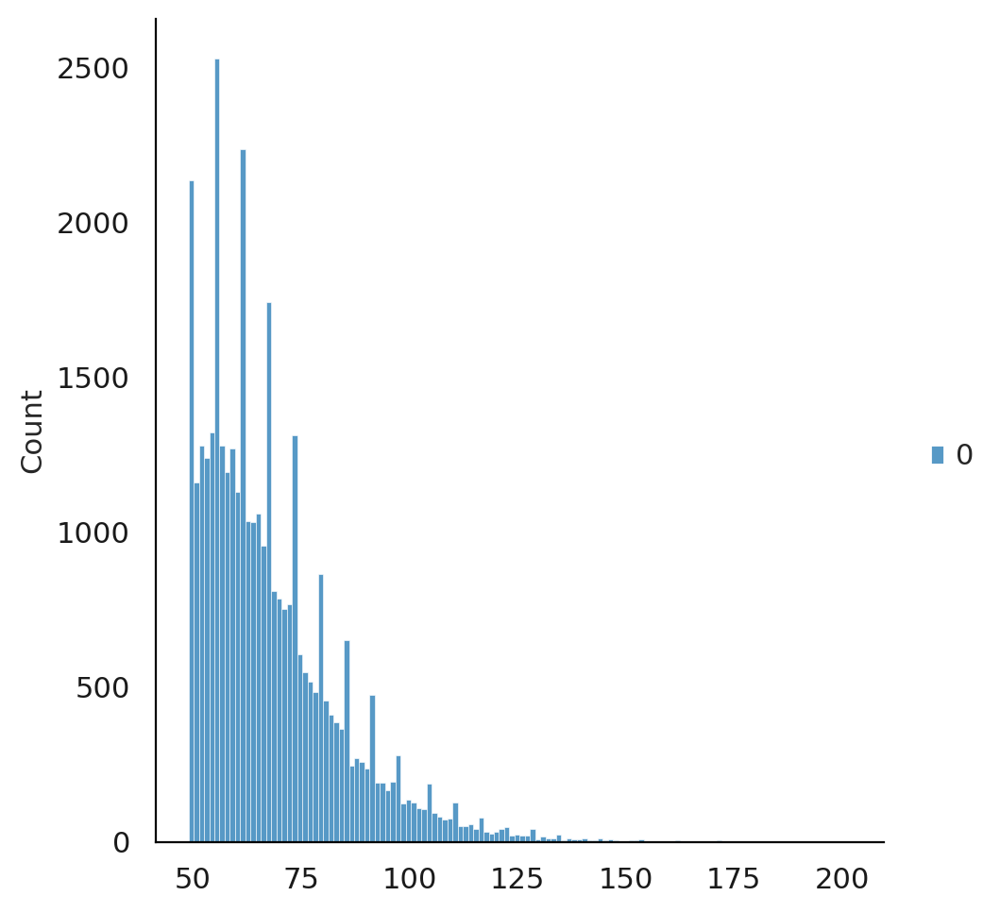

In [459]:
sns.displot(np.sum(combined_kernel.transition_matrix>0, axis = 1) ) 

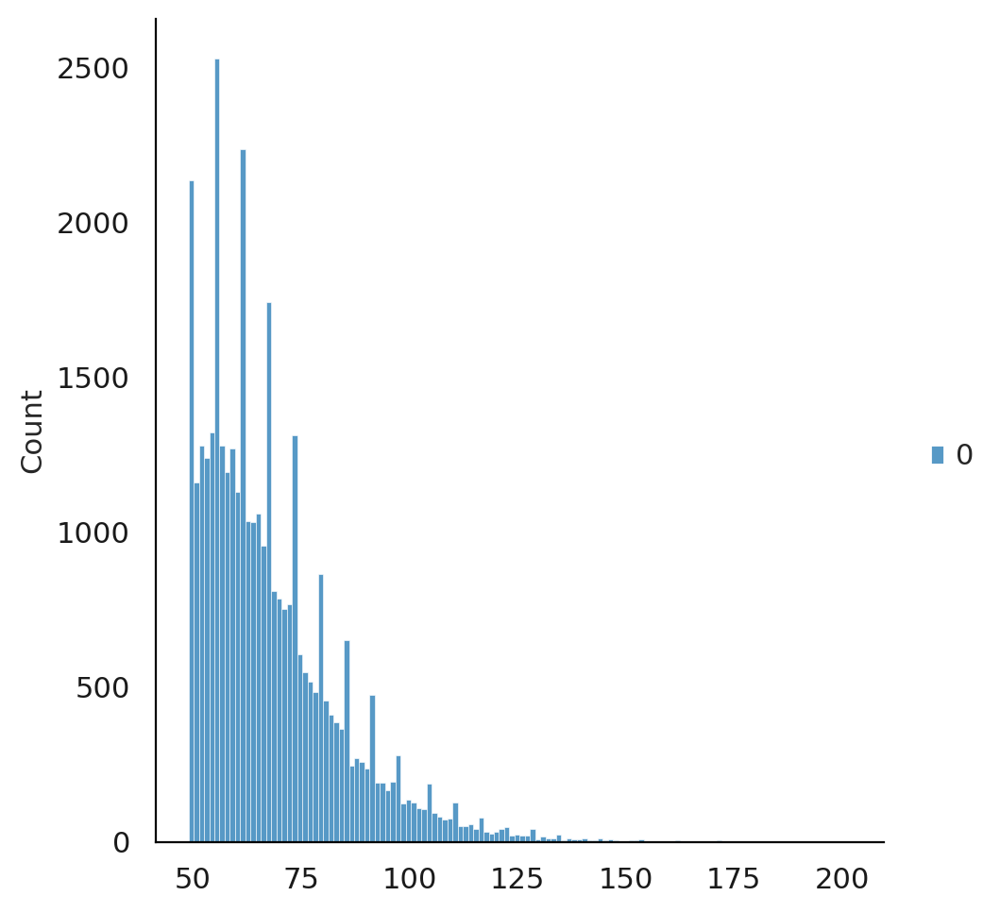

In [460]:
sns.displot(np.sum(combined_kernel.transition_matrix>0, axis = 0).T) 


In [461]:
combined_kernel.transition_matrix[0,:].toarray() ,  combined_kernel.transition_matrix[:,0].toarray().T

(array([[0., 0., 0., ..., 0., 0., 0.]]),
 array([[0., 0., 0., ..., 0., 0., 0.]]))

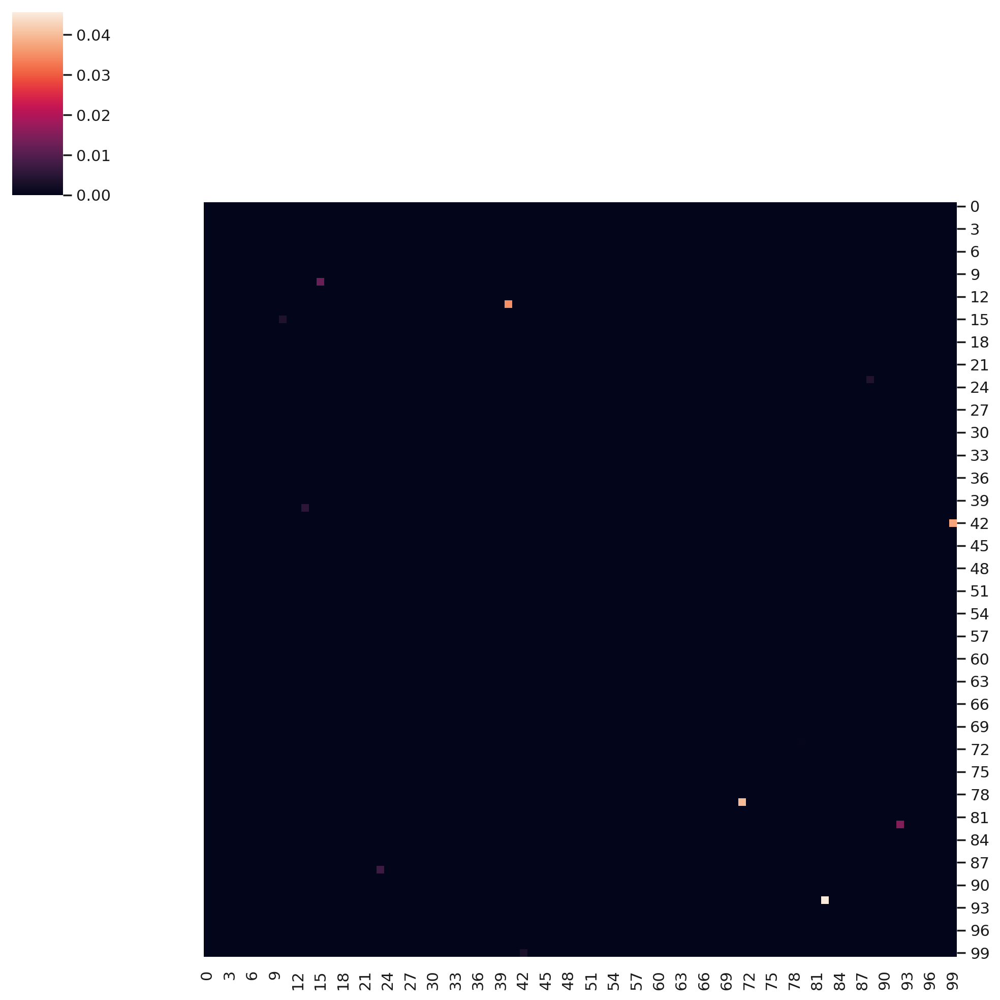

In [462]:
sns.clustermap(combined_kernel.transition_matrix[0:100,0:100].toarray() ,
              row_cluster=False, col_cluster=False) 

Time step multiplication gives us the probabilities of the next states 

In [463]:
# Let's define an initial condition
def make_state_transition(adata = [], transition_matrix = [], 
                    init_cluster ='10', 
                    n_steps = 1, 
                    label_id = 'seurat_clusters'): 
    # initial array of probs at t=0
    init_probs = np.zeros(adata.shape[0]) 
    #init_probs[0] = 1 # one cell as a starting point 

    n_init = np.sum(adata.obs[label_id]==init_cluster) 
    init_probs[adata.obs[label_id]==init_cluster] = 1/n_init # one full cluster as a starting point
    
    for i in range(n_steps):
        step_transition = transition_matrix.T.dot(init_probs)
        init_probs = step_transition
        
    return(step_transition) 
    

In [464]:
cell_type_label = 'annotation_umapv2_global'

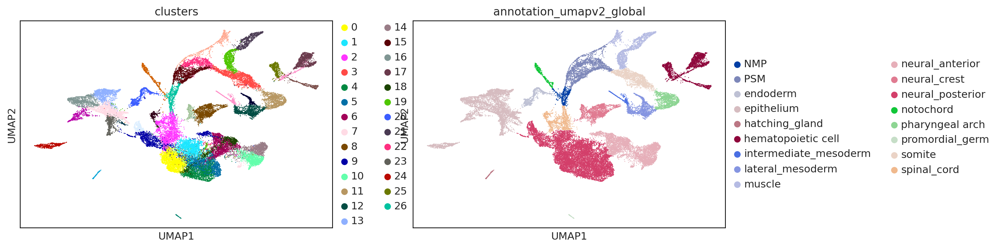

In [465]:
sc.pl.umap(adata_velo_early, color = ['clusters',cell_type_label ])

In [466]:
import matplotlib.pyplot as plt
def plot_umap_probs(adata= [], state_probabilities = []):
    df = pd.DataFrame( {'UMAP1': adata.obsm['X_umap'][:,0], 'UMAP2': adata.obsm['X_umap'][:,1], 
              'state_prob': state_probabilities } )
    sns.scatterplot(data = df, x ='UMAP1', y = 'UMAP2', hue ='state_prob', linewidth=0,s=2)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)


Let's get the probabilities for a cluster after a few steps

In [467]:
nmp_cluster = '26'

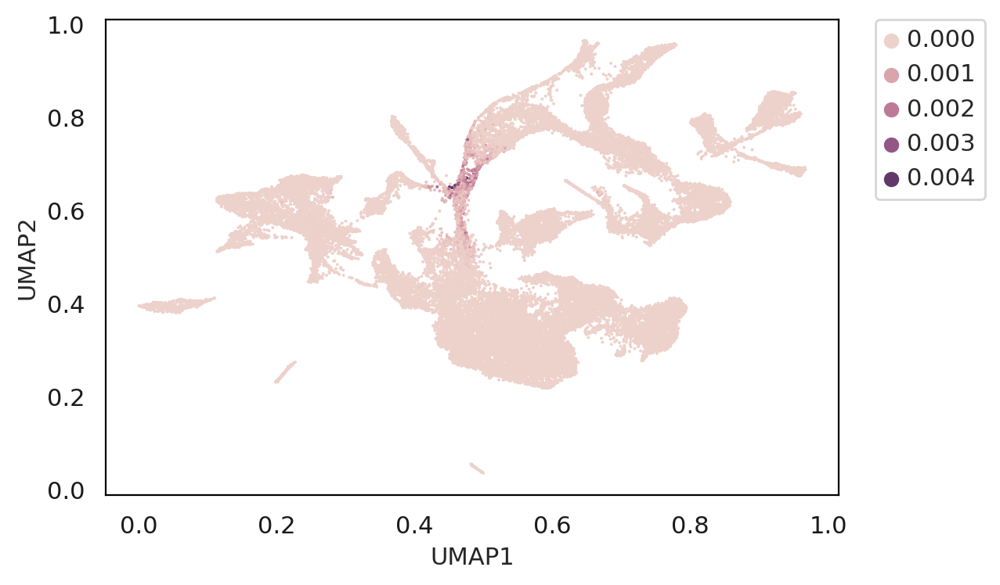

In [468]:
step_transition = make_state_transition(adata_velo_early, 
                                        transition_matrix = combined_kernel.transition_matrix, 
                                        init_cluster = nmp_cluster,
                                        n_steps = 2, 
                                        label_id = 'clusters') 


plot_umap_probs(adata_velo_early, step_transition) 

The state distribution should add to one (even after transitions)

In [469]:
np.sum(step_transition)

1.0

In [470]:
np.sum(combined_kernel.transition_matrix.T.dot(step_transition)) 

1.0000000000000002

All good

In [471]:
group_label = 'clusters'

<AxesSubplot:xlabel='clusters', ylabel='velocity_length'>

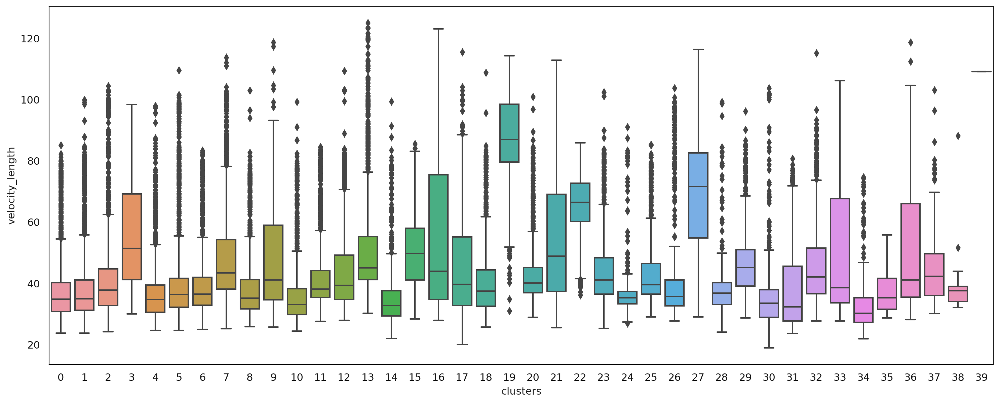

In [472]:
plt.figure(figsize=(18,7))

sns.boxplot(data= adata_velo_early.obs, x = 'clusters', y = 'velocity_length') 

* The transition matrix looks good
* Multiplication works 
* Let's merge with cell type annotations and then we can compute transitions for different cell types 

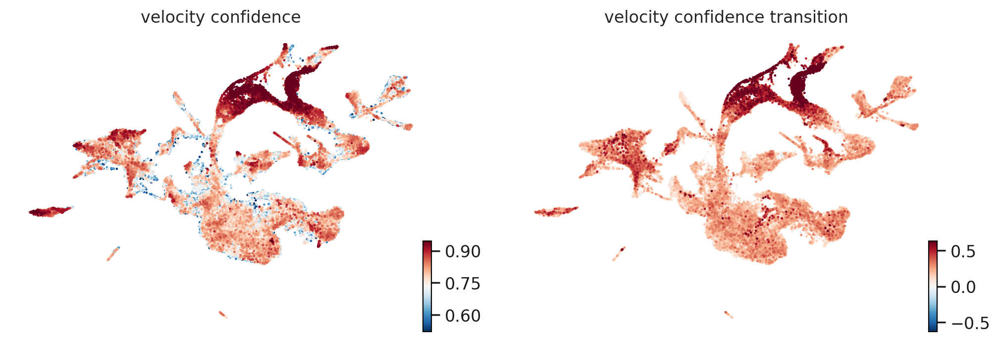

In [473]:

scv.pl.scatter(adata_velo_early, color=['velocity_confidence', 'velocity_confidence_transition'], perc=[2,98], colorbar=True)


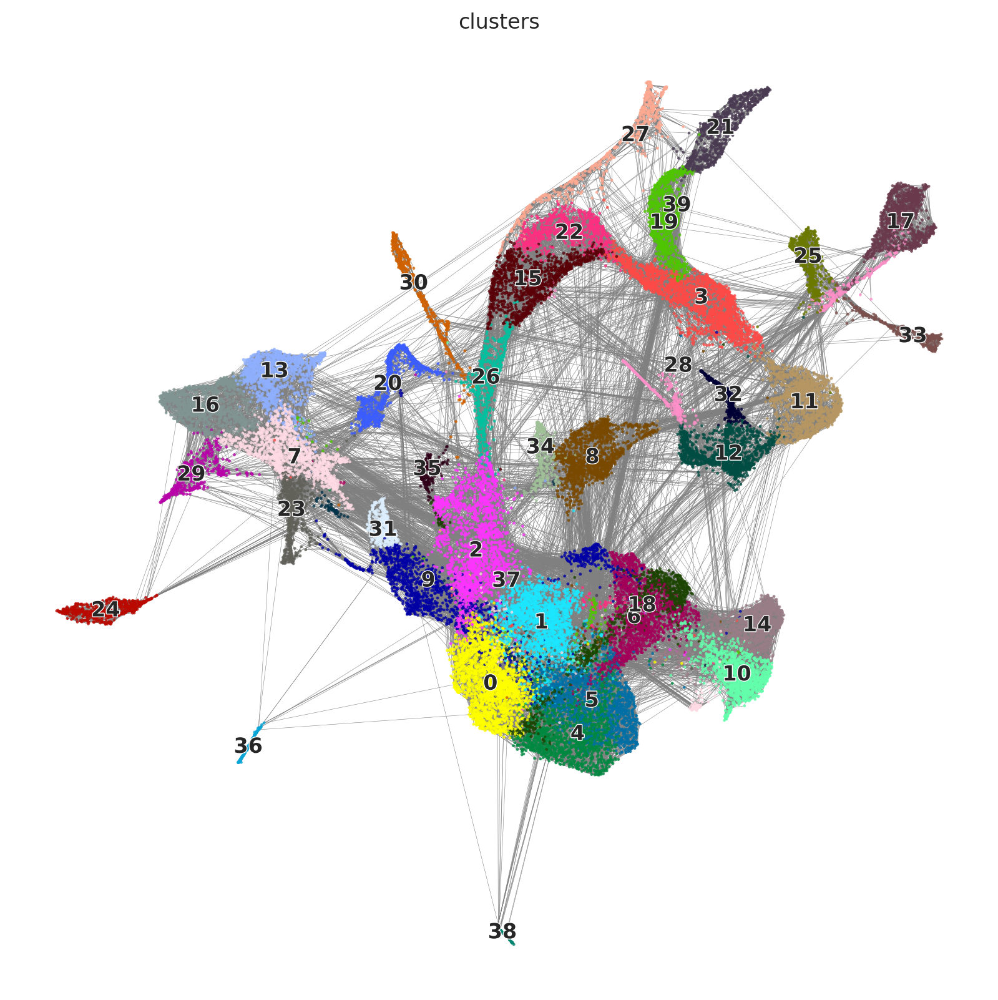

In [474]:
scv.pl.velocity_graph(adata_velo_early,
                     figsize = (10,10))

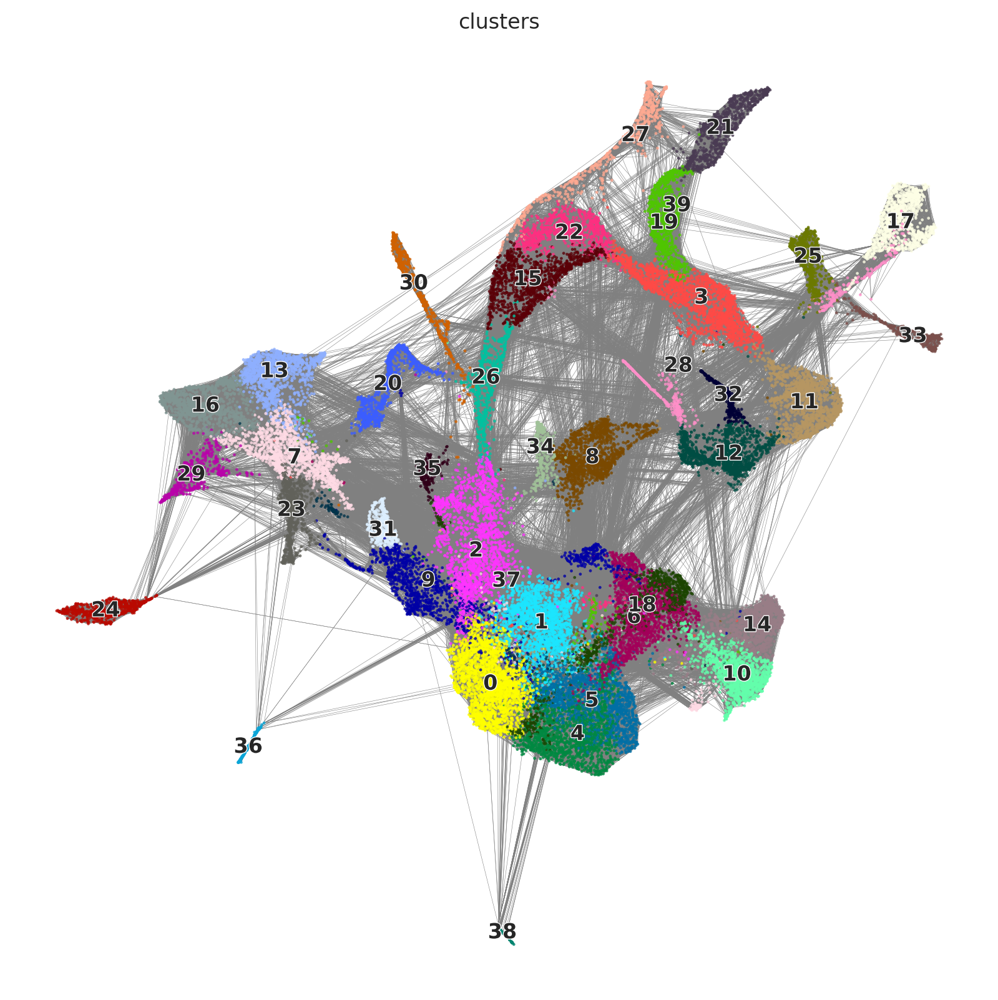

In [114]:
scv.pl.velocity_graph(adata_velo_early,
                     figsize = (10,10))

## Probability distribution in time by cluster 

In [475]:
# Let's make the transition plot more general so we can add any subset of cells as the initial condition 
# Let's define an initial condition
def make_state_transition_(transition_matrix = [], 
                    init_set = [] , # False True array of index  
                    n_steps = 1): 
    # initial array of probs at t=0
    init_probs = np.zeros(transition_matrix.shape[0]) 
    #init_probs[0] = 1 # one cell as a starting point 

    n_init = np.sum(init_set) # what's the size of the initial set 
    init_probs[init_set] = 1/n_init # one full cluster as a starting point
    
    for i in range(n_steps):
        step_transition = transition_matrix.T.dot(init_probs)
        init_probs = step_transition
        
    return(step_transition) 
    

In [476]:
# For a given cluster, calcualte the fractions of cells from each embryo 
# We use this information to define which embryos to track using the velocity graph 
# Embryos with low numbers of cells might be hard to consider 
def cluster_stats(adata = [], 
                  label = 'seurat_clusters', 
                  which_cluster = '10', 
                  group1= 'fish', 
                  group2 = 'timepoint'
                  ):
    df = pd.DataFrame(adata[adata.obs[label]==which_cluster].obs.groupby([group1,group2]).size()  ).sort_values(0, ascending = False)
    df.rename(columns = {0:'ncells'}, inplace = True)
    df = df[df['ncells']>0]
    df.reset_index(inplace = True)
    df.set_index('fish', inplace = True)
    
    # let's normalize by the total numbe of cells on each embryo
    total_embryo = pd.DataFrame(adata.obs.groupby('fish').size() ) 
    total_embryo.rename(columns = {0:'total_cells'}, inplace = True)

    # Merge both data frames 
    all_stats = pd.concat([df, total_embryo], axis = 1) 
    all_stats = all_stats[~all_stats.isna()['timepoint']]
    all_stats['relative'] = all_stats['ncells']/all_stats['total_cells'] #how many cells from each embryo are in the cluster 
    all_stats = all_stats.sort_values('relative', ascending = False)
    
    return(all_stats) 

Can we identify the clusters with the most cells from earlier timepoints <br> 
These will likely be the progenitor clusters 

In [477]:
# If seurat clusters don't exists already
adata_velo_early.obs['seurat_clusters'] = adata_velo_early.obs['clusters'].copy() 

### Cell fates 

In [478]:
def cluster_fracs(meta_data = [], # require a pre-computed meta data frame
                  which_cluster = '6', 
                  weight_prob = 1): 
    # For a terminal cluster (e.g. 6)
    df_clus = pd.DataFrame(meta_data[meta_data['seurat_clusters']==which_cluster].zebrafish_anatomy_ontology_class.value_counts() ) 
    df_clus.reset_index(inplace = True)
    df_clus.rename(columns = {'index':'cell_type','zebrafish_anatomy_ontology_class':'ncells'}, inplace = True)
    
    # expected number of cells based on the probability of the cluster 
    df_clus['weighted'] = df_clus['ncells'] * weight_prob
    return( df_clus) 
    

Let's compute the numbers of cell per cluster only once 

In [479]:
adata_velo_early.obs.head() 

,10X_run,barcode,batch,cell_annotation,cell_id2,global_annotation,timepoint,clusters,annotation_umapv2_recluster,annotation_umapv2_global,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,velocity_length,velocity_confidence,velocity_confidence_transition,seurat_clusters
cell_id,,,,,,,,,,,,,,,,,,,
TDR38_TAGAGTCCAGACCAAG-1,TDR38,TAGAGTCCAGACCAAG,0,Telencaphalon_Emx3,TDR38_TAGAGTCCAGACCAAG-1,Neural_Anterior,05somite,4,midbrain_en2a_pax5,neural_posterior,45303.0,8428.0,45303.0,30194.072266,0.533631,30.33,0.731758,0.059985,4
TDR44_ATAGACCTCGCACTCT-1,TDR44,ATAGACCTCGCACTCT,0,Midbrain_en2b.pax5.en2a,TDR44_ATAGACCTCGCACTCT-1,Neural_Posterior,30somite,4,midbrain_en2a_pax5,neural_posterior,19289.0,2282.0,19289.0,30803.623047,0.367137,36.10,0.650641,0.246687,4
TDR43_TCAGGGCTCTTGCGCT-1,TDR43,TCAGGGCTCTTGCGCT,0,EndothelialCells_kdrl,TDR43_TCAGGGCTCTTGCGCT-1,Epidermal,30somite,25,endothelia_cells_sox7_kdrl_yvk,hematopoietic cell,16713.0,1578.0,16713.0,30207.201172,0.369979,38.30,0.836476,0.251923,25
TDR18_CCTCACAGTAGATTAG-1,TDR18,CCTCACAGTAGATTAG,1,PSM_msgn1,TDR18_CCTCACAGTAGATTAG-1,PSM,10somite,15,psm_msgn1_hes6,PSM,17918.0,4028.0,17918.0,29897.742188,0.312287,47.09,0.903611,0.312891,15
TDR39_CCCATTGCAGACACAG-1,TDR39,CCCATTGCAGACACAG,0,OpticCup_rx1,TDR39_CCCATTGCAGACACAG-1,Neural_Anterior,15somite,37,optic_cuprx1_rx2_vsx2,neural_anterior,62907.0,15814.0,62907.0,30515.197266,0.375022,37.92,0.740157,0.209420,37


In [480]:


meta_data_master = adata_velo_early.obs[[cell_type_label,'clusters', 'timepoint']]
meta_data_master.rename(columns ={cell_type_label:'zebrafish_anatomy_ontology_class', 
                                 'clusters': 'seurat_clusters',
                                  }, inplace = True)
meta_data_master.head() 

,zebrafish_anatomy_ontology_class,seurat_clusters,timepoint
cell_id,,,
TDR38_TAGAGTCCAGACCAAG-1,neural_posterior,4,05somite
TDR44_ATAGACCTCGCACTCT-1,neural_posterior,4,30somite
TDR43_TCAGGGCTCTTGCGCT-1,hematopoietic cell,25,30somite
TDR18_CCTCACAGTAGATTAG-1,PSM,15,10somite
TDR39_CCCATTGCAGACACAG-1,neural_anterior,37,15somite


In [481]:
adata_velo_early.obs.rename(columns= {'10X_run':'fish'}, inplace = True)

In [482]:
# Define the initial set of cells with a more specific query 
# One embryo from cluster 10 

def compute_fates(
    which_fish = 'TDR24',
    init_cluster = '10',
    n_steps = 100,
    min_prob = 0.0001, 
    meta_data_ = []): 

    init_cells = (adata_velo_early.obs['seurat_clusters']==init_cluster) & (adata_velo_early.obs['fish']==which_fish) 
    init_cells.values

    print('N cells' + str(np.sum(init_cells.values)))
    # 1. state probabilities at time = 100 
    tran_probs = make_state_transition_(transition_matrix = combined_kernel.transition_matrix, 
                        init_set = init_cells.values , # False True array of index  
                        n_steps = n_steps)

    # Assign the state probabilities and merge with metadata 
    df_probs = pd.DataFrame( { 'cluster': adata_velo_early.obs['seurat_clusters'] , 'state_probs': tran_probs } )
    # summ over clusters 
    cluster_probs = df_probs.groupby(['cluster']).sum('state_probs').sort_values('state_probs', ascending = False)

    # 2. Cluster probs
    fate_clusters = cluster_probs[cluster_probs['state_probs']>min_prob]

    # Weighted sum for cell fates 
    final_probs = list() 
    for i in fate_clusters.index.to_list() : 
        final_probs.append(cluster_fracs(meta_data_, i, cluster_probs.loc[i,'state_probs'])) 

    df_fates = pd.concat(final_probs).groupby('cell_type').sum('weighted').sort_values('weighted', ascending = False)

    df_fates['fish'] = which_fish 
    df_fates.reset_index(inplace = True)
    return(df_fates)

In [483]:
def compare_embryo_fate(
                        init_clust = '10', 
                        which_timepoint = '0 budstage', 
                        steps_n = 100, 
                        threshold_prob = 0.0001,  # min prob to consider a cluster 
                        fish_list = [] , 
                        meta_df = [] ): 
   
    fish_list = adata_velo_early[(adata_velo_early.obs.seurat_clusters ==init_clust) & (adata_velo_early.obs.timepoint==which_timepoint)].obs.fish.value_counts()
    fish_list = fish_list.index.to_list() 

    df_list = []
    for fish in fish_list: 
        print('Processing...' + fish)
        # MAIN FUNCTION
        df= compute_fates( which_fish = fish, init_cluster = init_clust, n_steps = steps_n, min_prob = threshold_prob, 
                         meta_data_ = meta_df )
        df_list.append(df)
        
    df_concat = pd.concat(df_list, axis = 0 )
    
    return(df_concat)
    

In [484]:
%%time 
cl = nmp_cluster
tp = '0 budstage'

df_fates= compare_embryo_fate(
                              init_clust = cl, 
                              which_timepoint = tp,  
                              steps_n = 10, 
                             meta_df = meta_data_master)

Processing...TDR26
N cells20
Processing...TDR25
N cells16
Processing...TDR24
N cells10
Processing...TDR23
N cells9
CPU times: user 557 ms, sys: 0 ns, total: 557 ms
Wall time: 555 ms


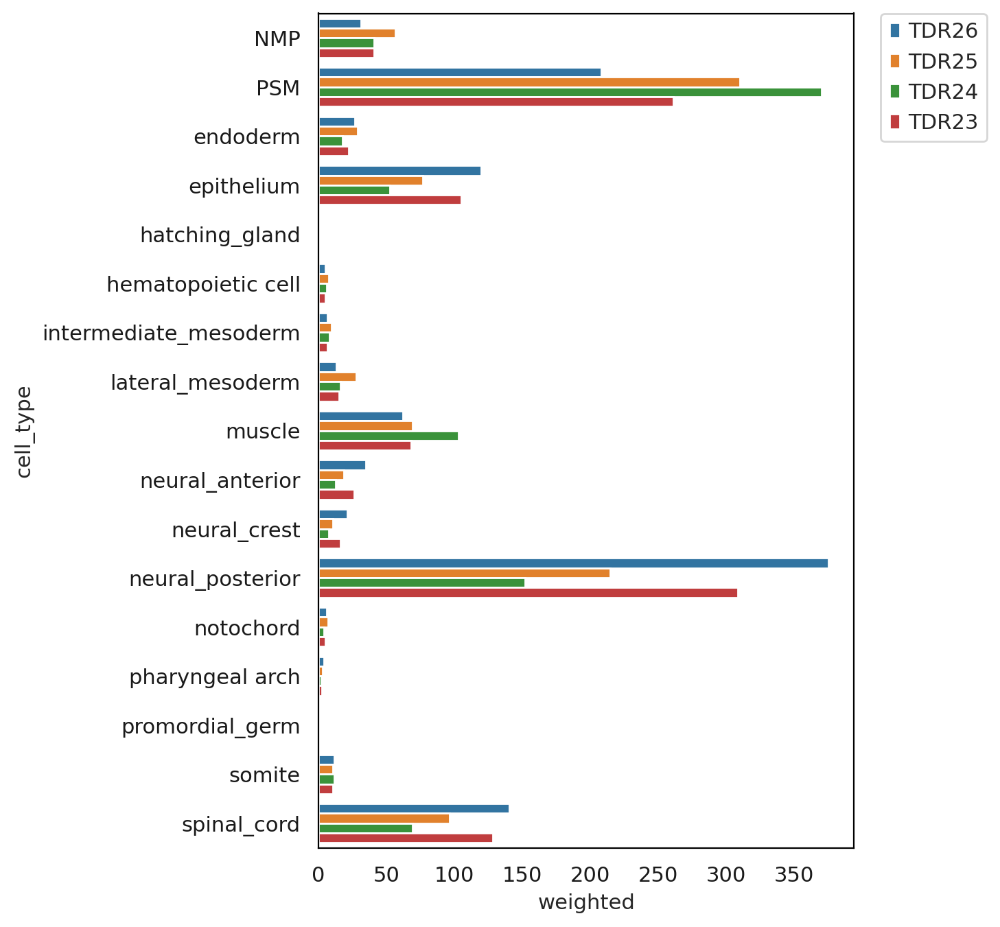

In [485]:
plt.figure(figsize = (5,8))
sns.barplot(data = df_fates, y = 'cell_type', x = 'weighted', hue = 'fish')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

Processing...TDR36
N cells74
Processing...TDR37
N cells74
Processing...TDR38
N cells54
Processing...TDR35
N cells31
CPU times: user 2 s, sys: 0 ns, total: 2 s
Wall time: 2 s


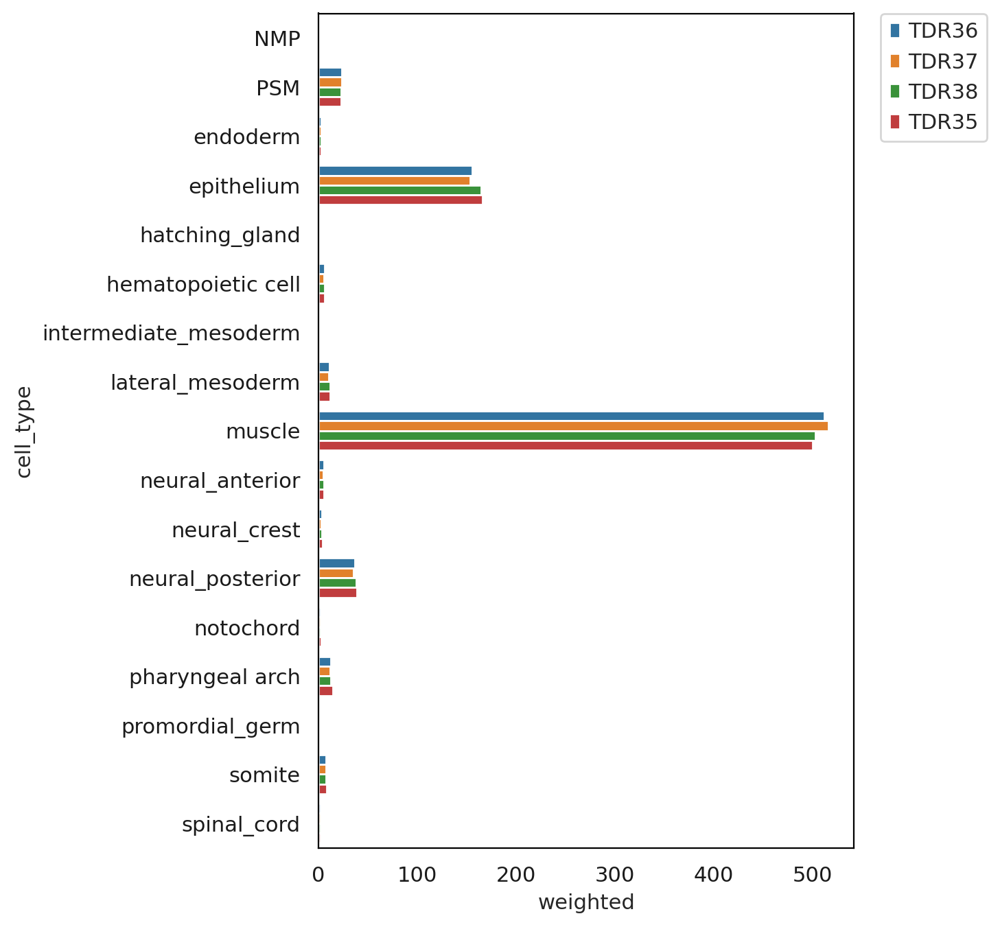

In [486]:
%%time
cl = nmp_cluster
tp = '05somite'

df_fates= compare_embryo_fate(init_clust = cl, 
                              which_timepoint = tp, 
                              steps_n = 100, 
                             meta_df = meta_data_master)


plt.figure(figsize = (5,8))

sns.barplot(data = df_fates, y = 'cell_type', x = 'weighted', hue = 'fish')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

Processing...TDR18
N cells68
Processing...TDR19
N cells32
Processing...TDR22
N cells13
Processing...TDR21
N cells10
CPU times: user 5.52 s, sys: 13.4 ms, total: 5.53 s
Wall time: 5.53 s


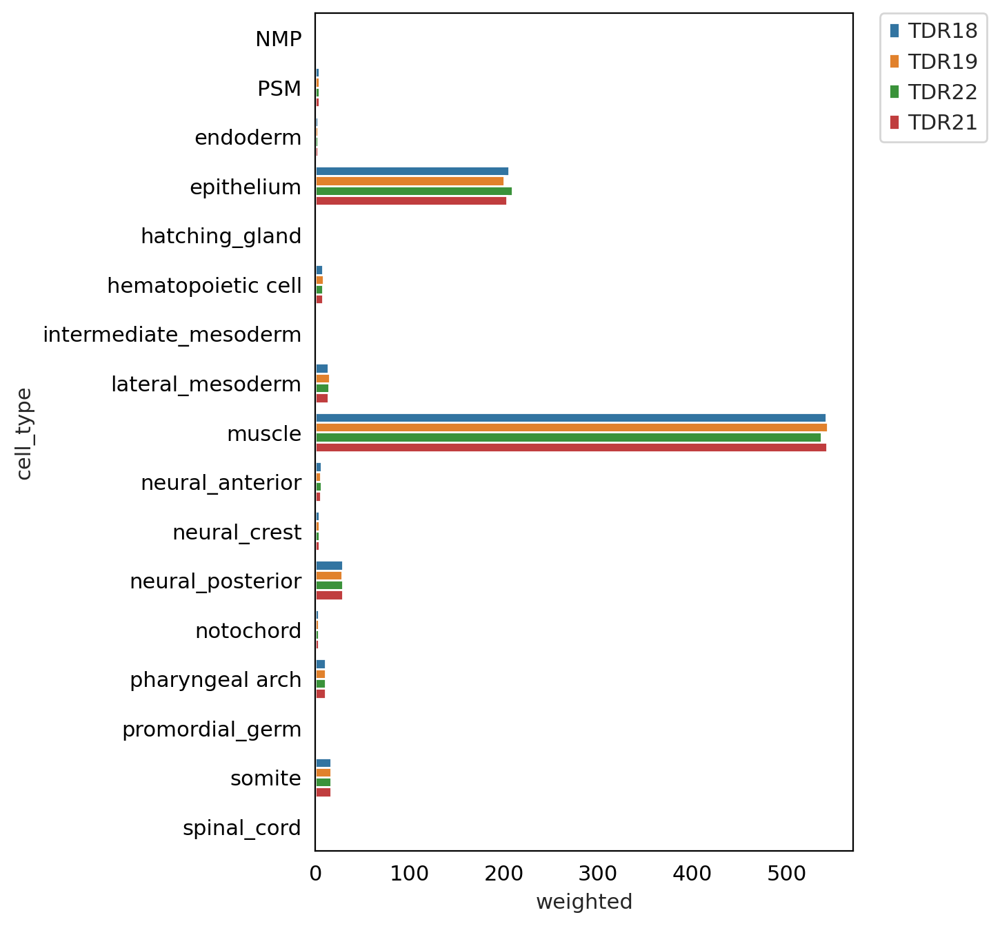

In [406]:
%%time
cl = nmp_cluster
tp = '10somite'

df_fates= compare_embryo_fate(init_clust = cl, 
                              which_timepoint = tp, 
                              steps_n = 100, 
                             meta_df = meta_data_master)


plt.figure(figsize = (5,8))

sns.barplot(data = df_fates, y = 'cell_type', x = 'weighted', hue = 'fish')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

Processing...TDR40
N cells37
Processing...TDR41
N cells30
Processing...TDR39
N cells24
Processing...TDR42
N cells8
CPU times: user 1.6 s, sys: 0 ns, total: 1.6 s
Wall time: 1.6 s


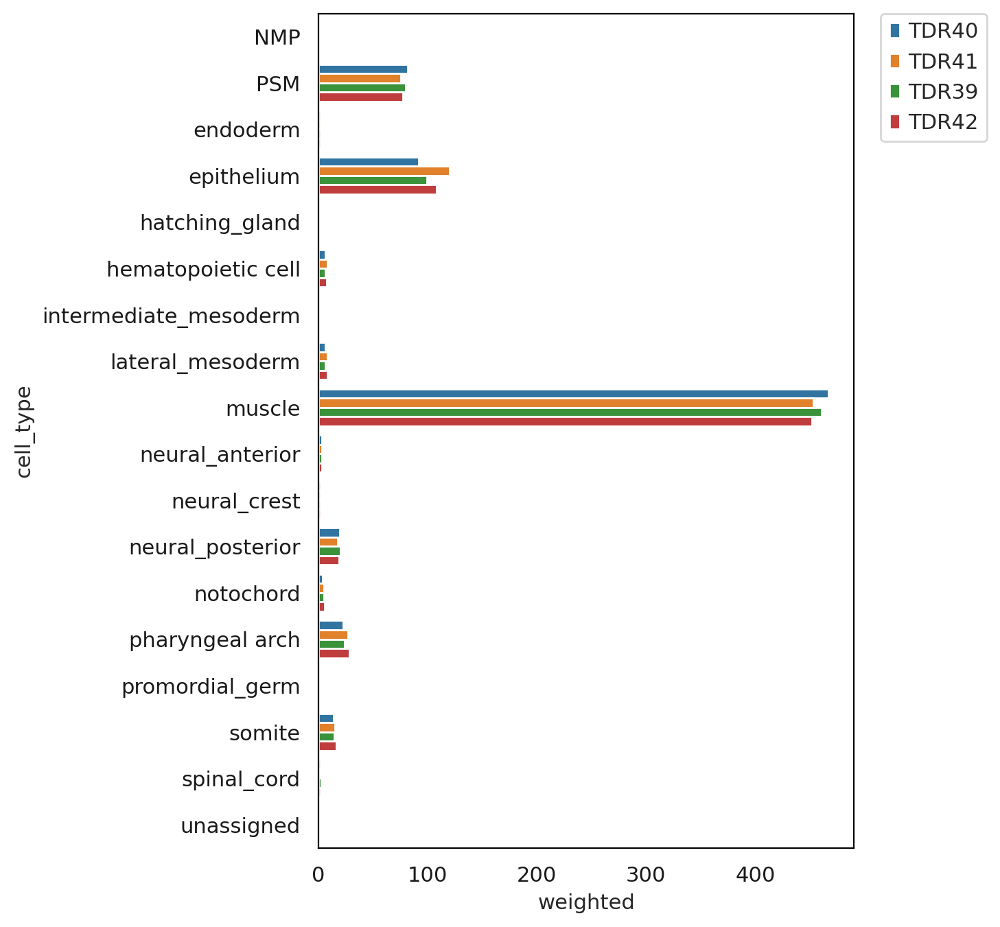

In [96]:
%%time
cl = nmp_cluster
tp = '15somite'

df_fates= compare_embryo_fate(init_clust = cl, 
                              which_timepoint = tp, 
                              steps_n = 100, 
                             meta_df = meta_data_master)


plt.figure(figsize = (5,8))

sns.barplot(data = df_fates, y = 'cell_type', x = 'weighted', hue = 'fish')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

Processing...TDR43
N cells20
Processing...TDR44
N cells19
Processing...TDR45
N cells4
Processing...TDR46
N cells4
CPU times: user 1.63 s, sys: 3.15 ms, total: 1.63 s
Wall time: 1.62 s


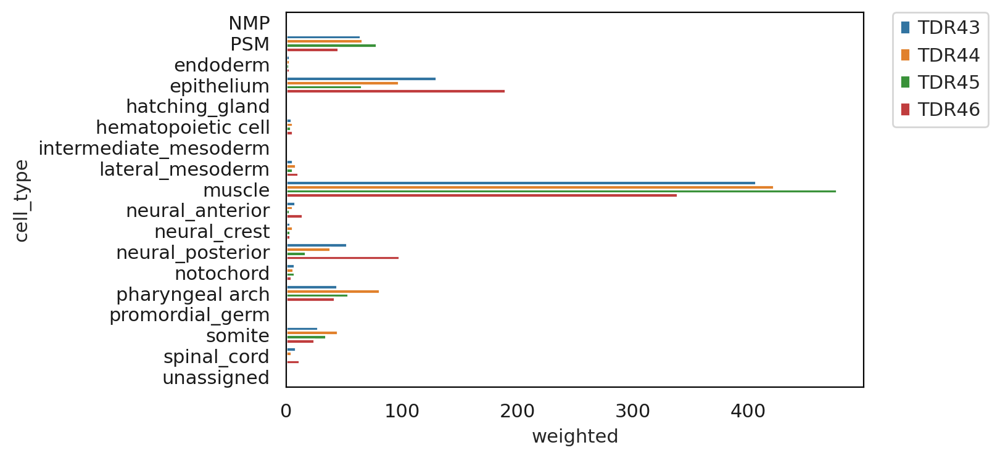

In [97]:
%%time
cl = nmp_cluster
tp = '30somite'

df_fates= compare_embryo_fate(init_clust = cl, 
                              which_timepoint = tp, 
                              steps_n =100, 
                             meta_df = meta_data_master)

sns.barplot(data = df_fates, y = 'cell_type', x = 'weighted', hue = 'fish')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

### Explore other progenitors

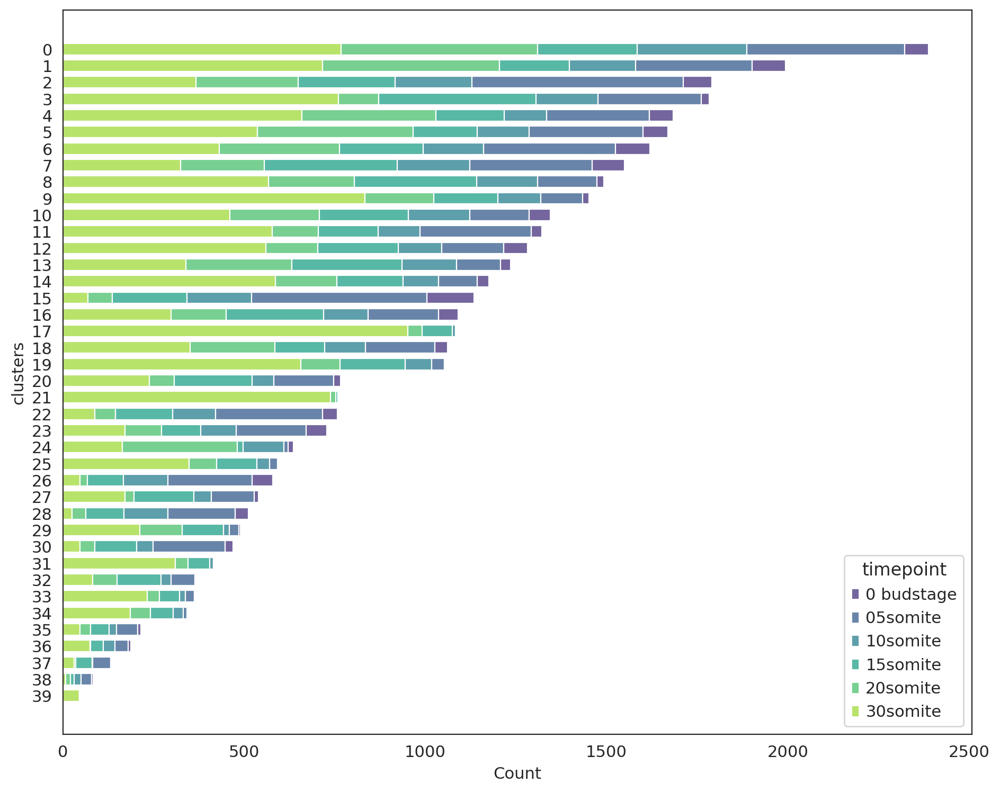

In [61]:
df_count = pd.DataFrame(adata_velo_early.obs.groupby(['timepoint', group_label]).size() ) 
df_count.reset_index(inplace = True)
df_count.rename(columns = {0:'n_cells'}, inplace = True ) 

# Draw a nested barplot by species and sex
# g = sns.catplot(
#     data=df_count, kind="bar",
#     x="seurat_clusters", y="n_cells", hue="timepoint",
#     palette="viridis", alpha=.6, height=6
# )
# g.despine(left=True)
# g.set_axis_labels("", "Cluster")
# g.legend.set_title("")

sorted_tissues = ['0 budstage','05somite','10somite','15somite',
                  '20somite','30somite']


import matplotlib.pyplot as plt
plt.figure(figsize=(11,9))
g = sns.histplot(y = group_label, 
                 stat = 'count',
                 hue = 'timepoint',weights= 'n_cells',
             multiple = 'stack',data=df_count,shrink = 0.7, 
             palette = 'viridis', hue_order = sorted_tissues)


Early cells clusters: 15, 22, 26 (nmp), 30, 28

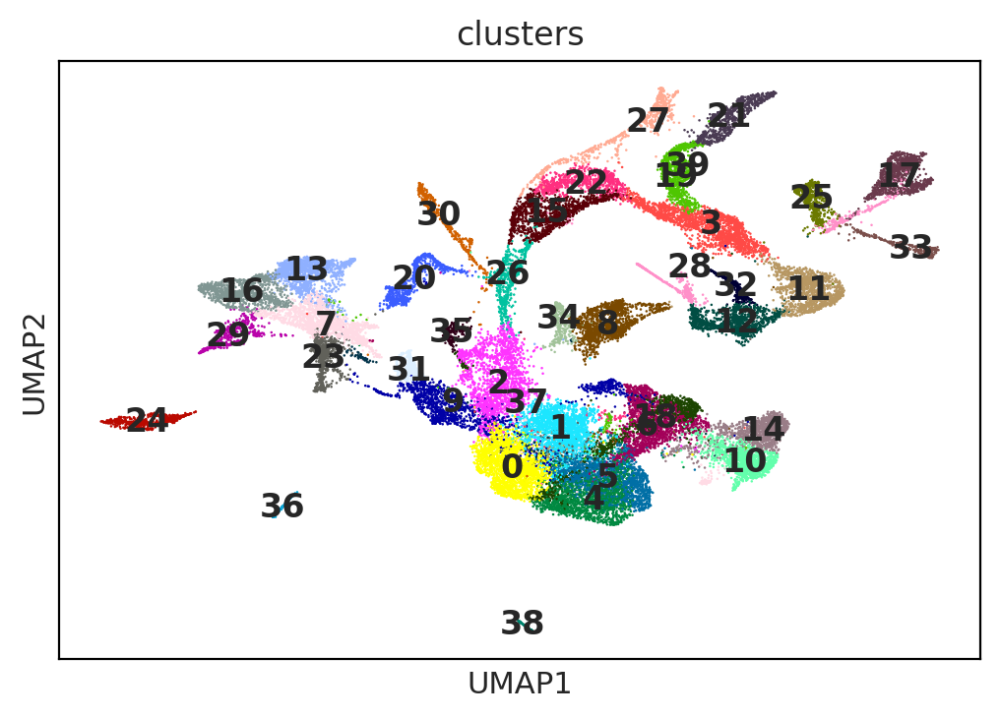

In [295]:
sc.pl.umap(adata_velo_early, color = 'clusters', legend_loc = 'on data')

Processing...TDR37
N cells61
Processing...TDR36
N cells56
Processing...TDR35
N cells34
Processing...TDR38
N cells34
CPU times: user 2.86 s, sys: 60.7 ms, total: 2.92 s
Wall time: 2.91 s


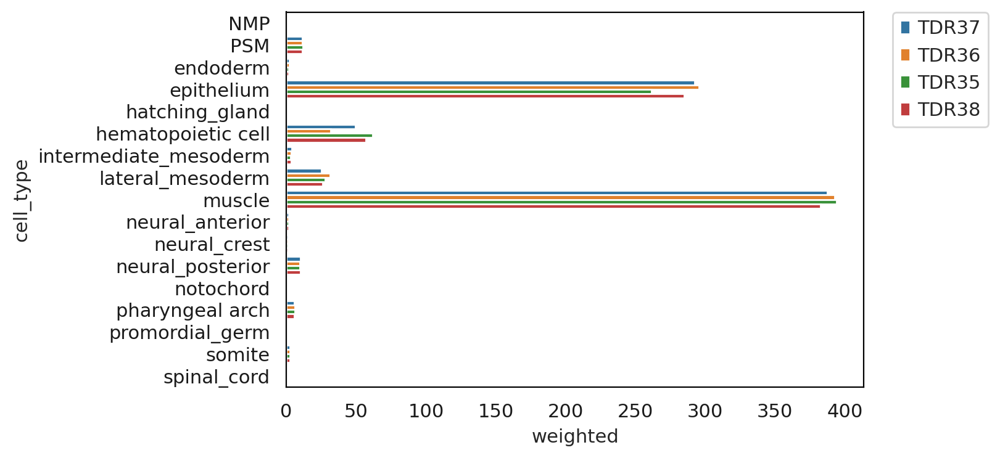

In [487]:
%%time
cl = '28'
tp = '05somite'

df_fates= compare_embryo_fate(init_clust = cl, 
                              which_timepoint = tp, 
                              steps_n = 200, 
                             meta_df = meta_data_master)



sns.barplot(data = df_fates, y = 'cell_type', x = 'weighted', hue = 'fish')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

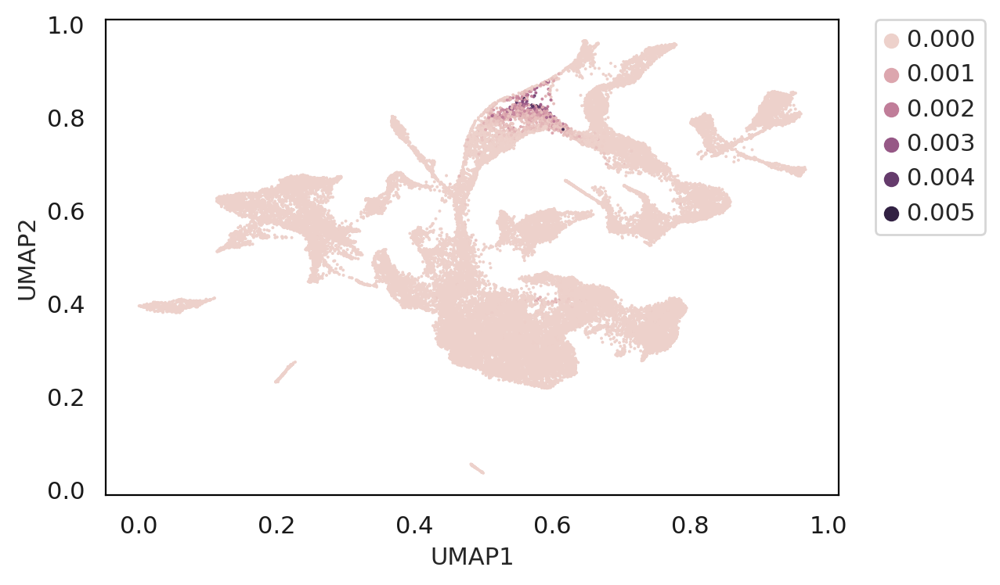

In [488]:
step_transition = make_state_transition(adata_velo_early, 
                                        transition_matrix = combined_kernel.transition_matrix, 
                                        init_cluster = '22',
                                        n_steps = 1, 
                                        label_id = 'clusters') 


plot_umap_probs(adata_velo_early, step_transition) 

## Keep track of the history 

* compute the state probs after t 
* merge with annotations 
* group and get summary stats 

* We can keep the whole history 

In [37]:
import matplotlib.pyplot as plt
sc.settings.set_figure_params(dpi=80, facecolor='white')

In [38]:
#%%time

# Let's make the transition plot more general so we can add any subset of cells as the initial condition 
# Let's define an initial condition
def make_state_transition_history(transition_matrix = [], 
                    init_set = [] , # False True array of index  
                    n_steps = 10): 
    # initial array of probs at t=0
    init_probs = np.zeros(transition_matrix.shape[0]) 
    pr_history = np.zeros((transition_matrix.shape[0],n_steps))
    #init_probs[0] = 1 # one cell as a starting point 

    n_init = np.sum(init_set) # what's the size of the initial set, logical array
    init_probs[init_set] = 1/n_init # one full cluster as a starting point
    
    if n_steps>0: 
        # step 0 should be the initial state 
        pr_history[:,0] = init_probs

        #until step -1 
        for i in range(1, n_steps):
            step_transition = transition_matrix.T.dot(init_probs)
            init_probs = step_transition
            pr_history[:,i] = step_transition

        return(pr_history) 
    else:
        return(init_probs)


# Define the initial set of cells with a more specific query 

def state_history(
                 which_fish = [], #which embryo to track
                 which_cluster = [], #progenitor population
                 n_step_history = 1000, # how many markov steps
                 group_var = 'zebrafish_anatomy_ontology_class' #for sum pr
                ):
    # use one of multiple fish as the initial state
    init_cells = (adata_velo_early.obs['seurat_clusters']==which_cluster) & (adata_velo_early.obs['fish'].isin(which_fish)) 


    # compute the history of states
    tran_probs10 = make_state_transition_history( transition_matrix = combined_kernel.transition_matrix, 
                        init_set = init_cells.values , # False True array of index  
                        n_steps = n_step_history)



    # Assign metadata and compute summary stats
    state_df = pd.DataFrame(tran_probs10, index=adata_velo_early.obs.index.to_list() )
    state_df['timepoint'] = adata_velo_early.obs.timepoint.values
    state_df['seurat_clusters'] = adata_velo_early.obs.seurat_clusters.values 


    #state_df = state_df.loc[common_cells,:] # for consistency 
    #state_df['hpf'] = ann_df.loc[common_cells,'hpf']
    state_df[group_var]= adata_velo_early.obs[group_var]

    step_list = list(range(n_step_history)) # make an index to sum probs for each timepoint
    # sum probabilities across the group var -- this could be cell type of seurat_cluster
    prob_df = state_df.groupby([group_var]).sum(step_list).sort_values(step_list[-1], ascending = False)
    
    return(prob_df)




def compile_history_df(sum_var = 'zebrafish_anatomy_ontology_class', 
                       fish_id = 'TDR36',
                       clust_id = '10',
                       steps_ = 1000, 
                       min_prob = 0.0001):
    
    # compute probs from an initital state and sum over a group variable
    prob_df = state_history(which_fish =fish_id,
                            which_cluster = clust_id,
                           n_step_history =steps_,
                           group_var = sum_var)

    prob_df.reset_index(inplace = True)

    cluster_plot = prob_df[sum_var].astype(str)

    #pandas.melt(frame, id_vars=None, value_vars=None, var_name=None, value_name='value', col_level=None, ignore_index=True
    prob_tidy = pd.melt(prob_df, id_vars = sum_var, var_name = 'time_step', value_name = 'prob')
    prob_tidy[sum_var] = prob_tidy[sum_var].astype(str)
    prob_tidy['-log_pr'] = np.log(prob_tidy['prob'])
    # specify the initial cluster 
    # initial conditions in terms of probabilities should be included in the distribution at t = 0
    prob_tidy['init_cluster'] = clust_id
    
    proba_tidy = prob_tidy[prob_tidy['prob']> min_prob]
    
    return(proba_tidy)

Test 

In [489]:
df_counts = pd.DataFrame(adata_velo_early[adata_velo_early.obs.seurat_clusters==nmp_cluster].obs.groupby(['timepoint','fish']).size())

df_counts.reset_index(inplace = True)
df_counts.rename(columns={0:'n_cells'},inplace = True)
df_counts = df_counts.loc[df_counts.n_cells>0,:]
df_counts.sort_values('n_cells',ascending= False).head(10)

,timepoint,fish,n_cells
33,05somite,TDR36,74
34,05somite,TDR37,74
44,10somite,TDR18,68
35,05somite,TDR38,54
81,15somite,TDR40,37
45,10somite,TDR19,32
32,05somite,TDR35,31
82,15somite,TDR41,30
80,15somite,TDR39,24
7,0 budstage,TDR26,20


In [40]:
# use one of multiple fish as the initial state
which_cluster = '26'
which_fish = df_counts.fish.unique().to_list() 

init_cells = (adata_velo_early.obs['seurat_clusters']==which_cluster) & (adata_velo_early.obs['fish'].isin(which_fish)) 


# compute the history of states
# if n_steps ==0 we return the initial condition 
tran_probs10 = make_state_transition_history( transition_matrix = combined_kernel.transition_matrix, 
                    init_set = init_cells.values , # False True array of index  
                    n_steps = 0)

Check that we are subsetting correctly. <br>
Looks good. All cells with prob >0 at t = 0 are from cluster 26 and we include cells from all embryos 

In [41]:
adata_velo_early[tran_probs10>0].obs.timepoint.value_counts() 

05somite      233
10somite      123
15somite       99
0 budstage     55
30somite       47
20somite       21
Name: timepoint, dtype: int64

In [42]:
adata_velo_early[tran_probs10>0].obs.annotation_umapv2_global.value_counts() 

NMP            434
PSM             73
spinal_cord     71
Name: annotation_umapv2_global, dtype: int64

Let's check the composition of the nmp cluster

In [490]:
%%time
group_var = 'clusters'
# Let's use all the cells from a given timepoint as the initial state 
fish_set = df_counts.loc[df_counts.timepoint=='0 budstage'].fish.values

# Use all cells in the cluster -- independent of the fish 
fish_set = df_counts.fish.unique().to_list() 

prob_tidy = compile_history_df(sum_var = group_var, 
                               fish_id = fish_set,
                               clust_id = nmp_cluster,
                               steps_ = 50, 
                               min_prob = 0.0001)

CPU times: user 348 ms, sys: 0 ns, total: 348 ms
Wall time: 347 ms


<AxesSubplot:xlabel='time_step', ylabel='prob'>

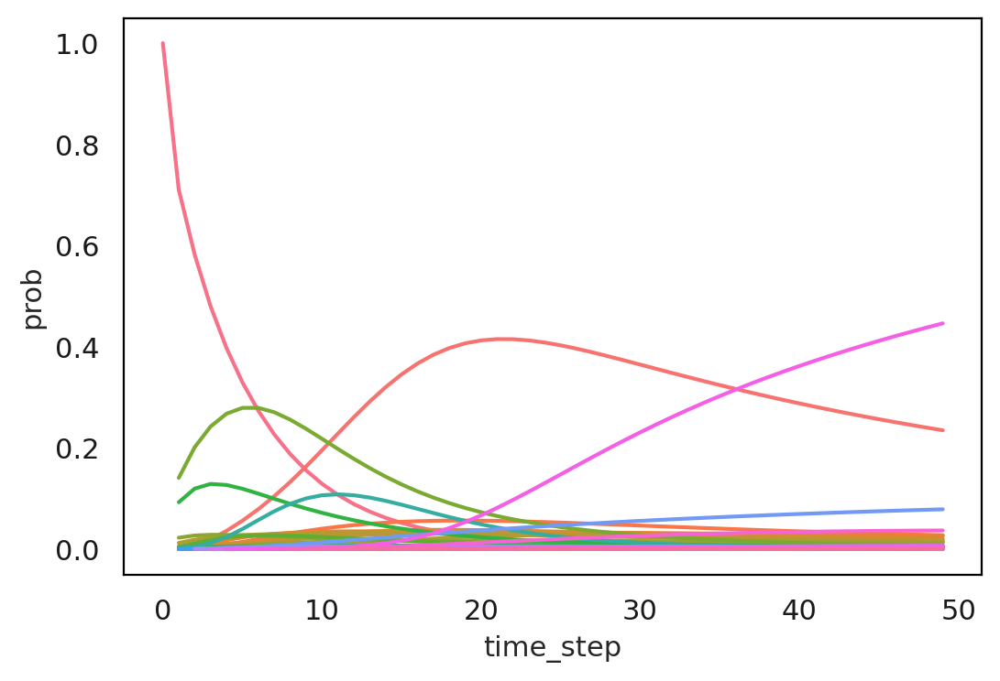

In [491]:
sns.lineplot(data = prob_tidy, 
             x = 'time_step', y = 'prob', hue = group_var, legend = False)
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

<AxesSubplot:xlabel='time_step', ylabel='prob'>

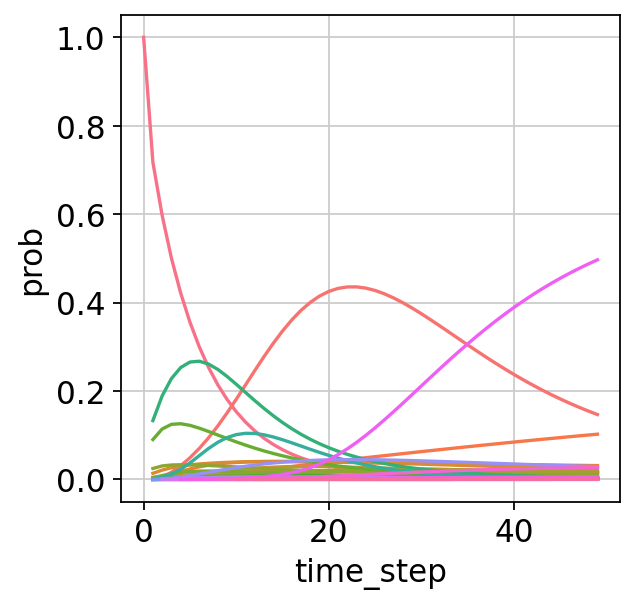

In [44]:
sns.lineplot(data = prob_tidy, 
             x = 'time_step', y = 'prob', hue = group_var, legend = False)
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

CPU times: user 880 ms, sys: 0 ns, total: 880 ms
Wall time: 879 ms


<AxesSubplot:xlabel='time_step', ylabel='prob'>

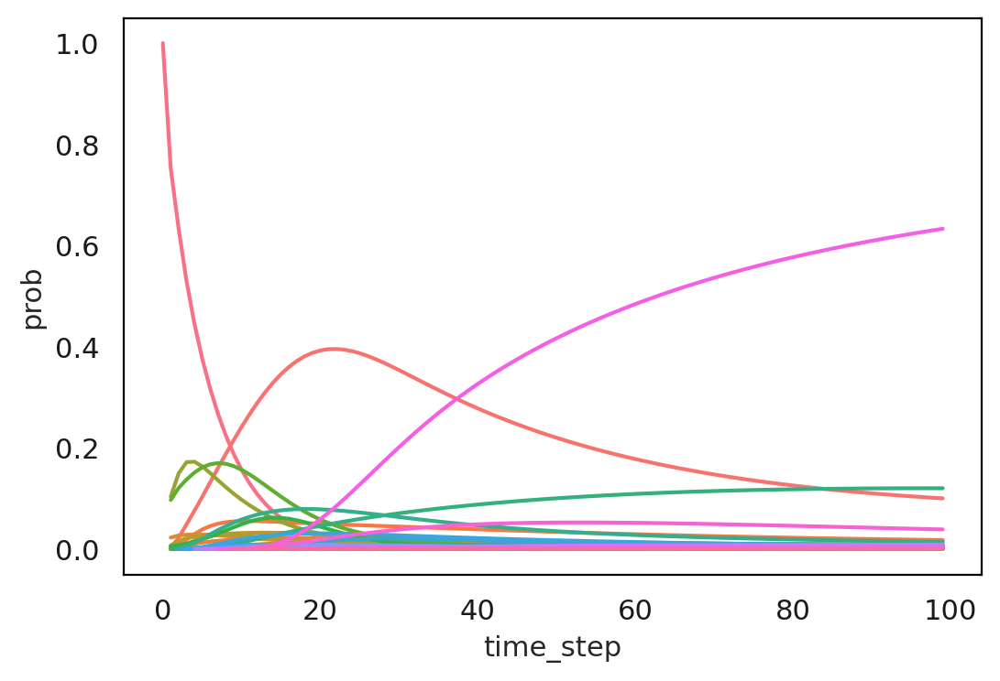

In [492]:
%%time
prob_tidy = compile_history_df(sum_var = group_var, 
                               fish_id = ['TDR37'],
                               clust_id = nmp_cluster,
                               steps_ = 100, min_prob = 0.0001)

sns.lineplot(data = prob_tidy, 
             x = 'time_step', y = 'prob', hue = group_var, legend = False)
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

Early cells clusters: 15, 22, 26 (nmp), 30, 28

WE can also use the cell types labels for grouping

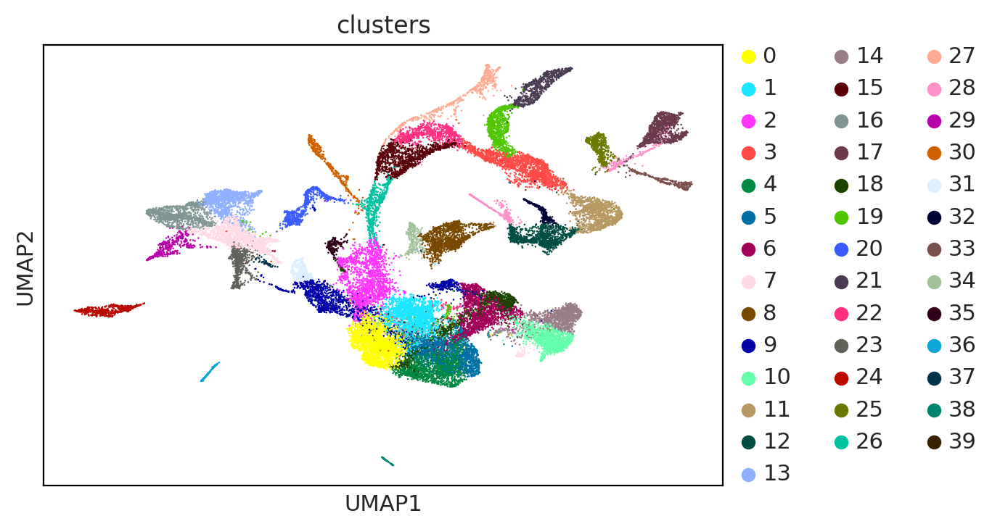

In [493]:
sc.pl.umap(adata_velo_early, color='clusters')

CPU times: user 465 ms, sys: 0 ns, total: 465 ms
Wall time: 464 ms


<AxesSubplot:xlabel='time_step', ylabel='prob'>

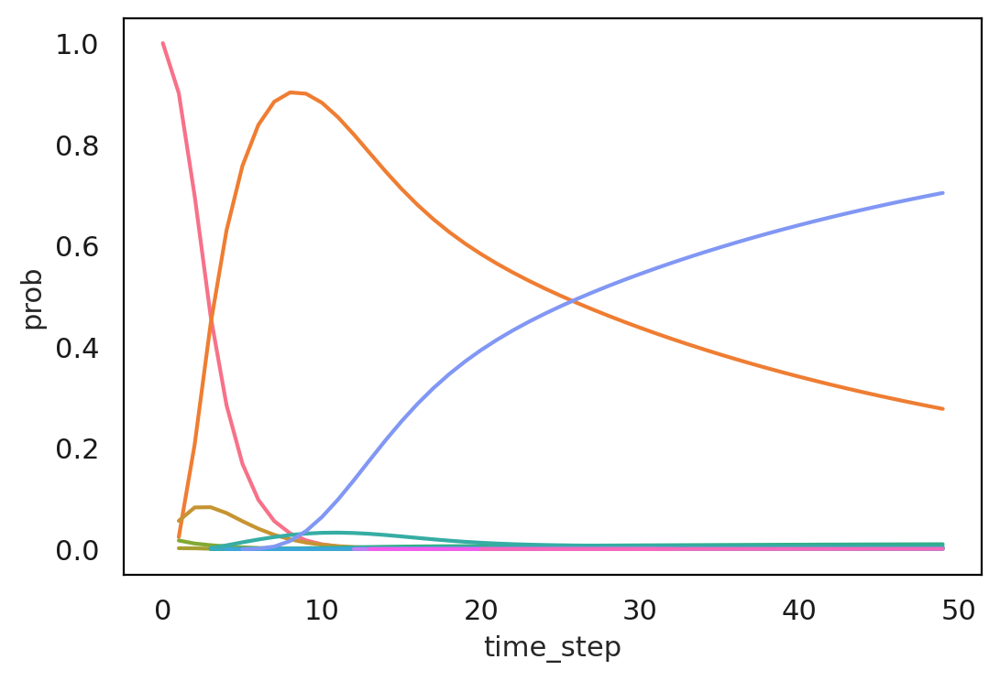

In [494]:
%%time
prob_tidy = compile_history_df(sum_var = group_var, 
                               fish_id = ['TDR28'],
                               clust_id = '22',
                               steps_ = 50)

sns.lineplot(data = prob_tidy, 
             x = 'time_step', y = 'prob', hue = group_var, legend =False)
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

In [495]:
fish_counts =pd.DataFrame(adata_velo_early.obs.groupby(['timepoint','fish']).size()) 
fish_counts.reset_index(inplace = True)
fish_counts.rename(columns={0:'n_cells'},inplace = True)
fish_counts = fish_counts[fish_counts['n_cells'] >0 ]
fish_counts.head()

,timepoint,fish,n_cells
4,0 budstage,TDR23,198
5,0 budstage,TDR24,181
6,0 budstage,TDR25,293
7,0 budstage,TDR26,579
36,05somite,TDR35,1204


### Compute transition probabilities and state histories for all clusters 

In [496]:
# We start from a given cluster and track cell fates until the prob distribution converges -- 
# we do this for all clusters 

group_var = 'clusters'
# Use all cells in the cluster -- independent of the fish 
fish_set = df_counts.fish.unique().to_list()  #
all_clusters = adata_velo_early.obs.clusters.unique().to_list() 

df_history_list =list() 


for c in all_clusters: 
    prob_tidy = compile_history_df(sum_var = group_var, 
                                   fish_id = fish_set, #use all fish 
                                   clust_id = c,
                                   steps_ = 100, # let's see if this converges 
                                   min_prob = 0.0001)
    
    print('finished cluster ' + c )
    df_history_list.append(prob_tidy)
    


finished cluster 4
finished cluster 25
finished cluster 15
finished cluster 37
finished cluster 16
finished cluster 35
finished cluster 10
finished cluster 13
finished cluster 19
finished cluster 32
finished cluster 21
finished cluster 14
finished cluster 3
finished cluster 22
finished cluster 5
finished cluster 7
finished cluster 23
finished cluster 8
finished cluster 9
finished cluster 17
finished cluster 0
finished cluster 11
finished cluster 28
finished cluster 27
finished cluster 2
finished cluster 31
finished cluster 20
finished cluster 6
finished cluster 1
finished cluster 18
finished cluster 33
finished cluster 24
finished cluster 12
finished cluster 30
finished cluster 36
finished cluster 29
finished cluster 26
finished cluster 34
finished cluster 38
finished cluster 39


In [497]:
df_fates = pd.concat(df_history_list)
df_fates = df_fates[df_fates.prob > 0.01]

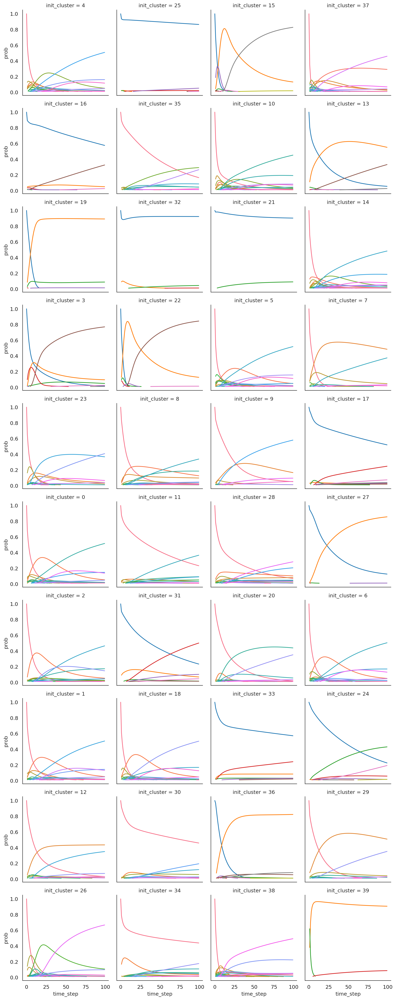

In [498]:
g = sns.FacetGrid(df_fates, col="init_cluster", col_wrap = 4)
g.map(sns.lineplot, "time_step", "prob", group_var )

In [499]:
df_fates.reset_index(inplace = True, drop = True)
df_fates.rename(columns = {'-log_pr': 'neg_log_prob'}, inplace = True)
df_fates.head() 

,clusters,time_step,prob,neg_log_prob,init_cluster
0,4,0,1.000000,0.000000,4
1,1,1,0.059020,-2.829874,4
2,0,1,0.066407,-2.711950,4
3,18,1,0.045397,-3.092311,4
4,4,1,0.599595,-0.511500,4


Export data frame for visualization in R 

In [500]:
pwd

'/data/alejandro/danio-atlas/data/zebrahub/analysis'

In [501]:
df_fates.to_csv('results/velocity_fate_trajectories_deterKernel_k10_veloK10.csv', index = False)

In [115]:
import cellrank as cr
cr.__version__

'1.1.0'

In [116]:
import scanpy as sc 
sc.__version__

'1.8.1'